<a href="https://colab.research.google.com/github/Alexey-Shkotov/ML_homeworks/blob/main/hw_2_taxi/homework_practice_02_linregr_Shkotov.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Машинное обучение, ФКН ВШЭ

## Практическое задание 2. Exploratory Data Analysis и линейная регрессия

### Общая информация
Дата выдачи: 05.10.2023

Мягкий дедлайн: 23:59MSK 18.10.2023

Жесткий дедлайн: 23:59MSK 22.10.2022

### О задании
В этом задании мы попытаемся научиться анализировать данные и выделять из них полезные признаки. Мы также научимся пользоваться `seaborn` и `sklearn`, а заодно привыкнем к основным понятиям машинного обучения.

### Оценивание и штрафы
Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). Максимально допустимая оценка за работу — 10 баллов. Проверяющий имеет право снизить оценку за неэффективную реализацию или неопрятные графики.

**Обратите внимание**, что в каждом разделе домашнего задания есть оцениваниемые задачи и есть вопросы. Вопросы дополняют задачи и направлены на то, чтобы проинтерпретировать или обосновать происходящее. Код без интерпретации не имеет смысла, поэтому отвечать на вопросы обязательно — за отсутствие ответов мы будем снижать баллы за задачи. Если вы ответите на вопросы, но не напишете корректный код к соответствующим оцениваемым задачам, то баллы за такое выставлены не будут.

Сдавать задание после указанного срока сдачи нельзя. При выставлении неполного балла за задание в связи с наличием ошибок на усмотрение проверяющего предусмотрена возможность исправить работу на указанных в ответном письме условиях.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

### Формат сдачи
Задания сдаются через систему Anytask. Инвайт можно найти на странице курса. Присылать необходимо ноутбук с выполненным заданием. Сам ноутбук называйте в формате homework-practice-02-linregr-Username.ipynb, где Username — ваша фамилия.

Для удобства проверки самостоятельно посчитайте свою максимальную оценку (исходя из набора решенных задач) и укажите ниже.

Оценка: **7**.

В этом ноутбуке используется библиотека `folium` для визуализации карт. Она работает в google colab!

In [1]:
!pip install folium

In [2]:
import folium

m = folium.Map(location=(55.7522200, 37.6155600), zoom_start=10)

m

Если вы всё сделали правильно, то выше должна открыться карта Москвы.

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

sns.set(style="darkgrid")

np.random.seed(42)

## Часть 0. Подготовка (1 балл)

**Задание 1 (1 балл)**. Мы будем работать с данными из соревнования [New York City Taxi Trip Duration](https://www.kaggle.com/c/nyc-taxi-trip-duration/overview), в котором нужно было предсказать длительность поездки на такси. Скачайте обучающую выборку из этого соревнования и загрузите ее:

**Скачаем датасет:**

In [8]:
!wget  -O 'train.csv' -q https://www.dropbox.com/scl/fi/cgf56xivqp5fcjrpsqsw8/train.csv?rlkey=80yzcmwd3wi5x4t97e3iu8anr&st=6vdwdaju&dl=0

**Создадим по train.csv pandas DataFrame:**

In [9]:
df = pd.read_csv('train.csv')
df.head(10)

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,429
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,435
5,id0801584,2,2016-01-30 22:01:40,2016-01-30 22:09:03,6,-73.982857,40.742195,-73.992081,40.749184,N,443
6,id1813257,1,2016-06-17 22:34:59,2016-06-17 22:40:40,4,-73.969017,40.757839,-73.957405,40.765896,N,341
7,id1324603,2,2016-05-21 07:54:58,2016-05-21 08:20:49,1,-73.969276,40.797779,-73.922470,40.760559,N,1551
8,id1301050,1,2016-05-27 23:12:23,2016-05-27 23:16:38,1,-73.999481,40.738400,-73.985786,40.732815,N,255
9,id0012891,2,2016-03-10 21:45:01,2016-03-10 22:05:26,1,-73.981049,40.744339,-73.973000,40.789989,N,1225


In [10]:
df.shape

(1458644, 11)

Обратите внимание на колонки `pickup_datetime` и `dropoff_datetime`. `dropoff_datetime` был добавлена организаторами только в обучающую выборку, то есть использовать эту колонку нельзя, давайте удалим ее. В `pickup_datetime` записаны дата и время начала поездки. Чтобы с ней было удобно работать, давайте преобразуем даты в `datetime`-объекты

In [11]:
df.drop(columns={"dropoff_datetime"}, inplace=True)
df["pickup_datetime"] = pd.to_datetime(df["pickup_datetime"])

In [12]:
df.head()

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id2875421,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N,455
1,id2377394,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N,663
2,id3858529,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N,2124
3,id3504673,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N,429
4,id2181028,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N,435


**Быстрая проверка, что всё теперь, как надо:**

In [13]:
df.shape

(1458644, 10)

In [14]:
df.dtypes

,0
id,object
vendor_id,int64
pickup_datetime,datetime64[ns]
passenger_count,int64
pickup_longitude,float64
pickup_latitude,float64
dropoff_longitude,float64
dropoff_latitude,float64
store_and_fwd_flag,object
trip_duration,int64


В колонке `trip_duration` записано целевое значение, которое мы хотим предсказывать. Давайте посмотрим на распределение таргета в обучающей выборке. Для этого нарисуйте его гистограмму:

<Axes: xlabel='trip_duration', ylabel='Count'>

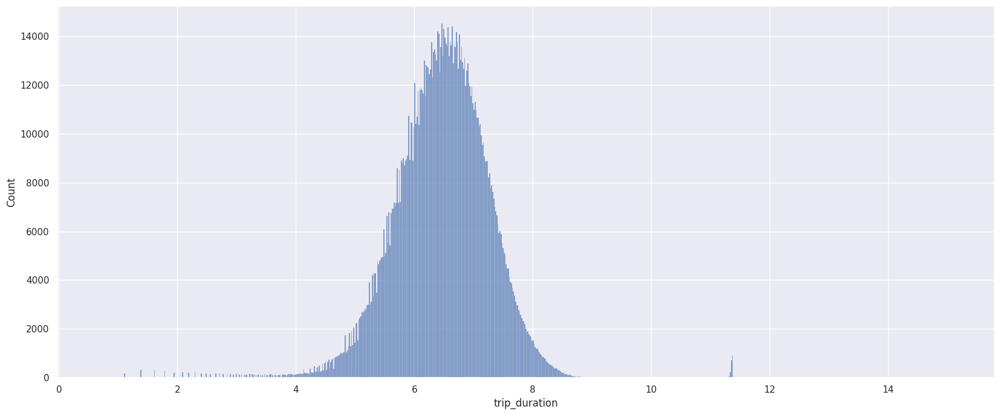

In [30]:
sns.set(rc={'figure.figsize':(20, 8)})
sns.histplot(np.log1p(df['trip_duration']))

**Вопрос**: Что можно сказать о целевой переменной по гистограмме её значений?

**Ответ:**
Имеет близкое к нормальному распределение(после логарифмирования)

В соревновании в качестве метрики качества использовалось RMSLE:
$$\text{RMSLE}(X, y, a) = \sqrt{\frac{1}{\ell}\sum_{i=1}^{\ell} \big(\log{(y_i + 1)} - \log{(a(x_i) + 1)}\big)^2}$$

**Вопрос**: Как вы думаете, почему авторы соревнования выбрали именно RMSLE, а не RMSE?

**Ответ:** используем на данной выборке именно RMSLE, так как:
- из-за выбросов у нас очень длинный хвост у плотности распределения таргета => хотим определять скорее не саму ошибку, а порядок ошибки
- RMSLE не так сильно, как RMSE, в силу несимметричности логарифма будет штрафовать нас за завышение прогноза, как за занижение => так мы будем менее зависимы от выбросов => будет меньше переобучение.

При этом значения целевой переменной строго положительны (и полагаем, что разумные предсказания модели - тоже или как минимум - неотрицательные) => не будет проблем с областью определения RMSLE.

На семинаре мы рассматривали несколько моделей линейной регрессии в `sklearn`, но каждая из них оптимизировала среднеквадратичную ошибку (MSE), а не RMSLE. Давайте проделаем следующий трюк: будем предсказывать не целевую переменную, а ее *логарифм*. Обозначим $\hat{y}_i = \log{(y_i + 1)}$ — модифицированный таргет, а $\hat{a}(x_i)$ — предсказание модели, которая обучалась на $\hat{y}_i$, то есть логарифм таргета. Чтобы предсказать исходное значение, мы можем просто взять экспоненту от нашего предсказания: $a(x_i) = \exp(\hat{a}(x_i)) - 1$.

**Вопрос**: Покажите, что оптимизация RMSLE для модели $a$ эквивалентна оптимизации MSE для модели $\hat{a}$.

**Доказательство**:

$$\text{RMSLE}(X, y, a) = \sqrt{\frac{1}{\ell}\sum_{i=1}^{\ell} \big(\log{(y_i + 1)} - \log{(a(x_i) + 1)}\big)^2} = \sqrt{\frac{1}{\ell}\sum_{i=1}^{\ell} \big(\hat{y}_i - \log({\exp(\hat{a}(x_i)) - 1 + 1)}\big)^2} = \sqrt{\frac{1}{\ell}\sum_{i=1}^{\ell} \big(\hat{y}_i - \log({\exp(\hat{a}(x_i)))}\big)^2} = \sqrt{\frac{1}{\ell}\sum_{i=1}^{\ell} \big(\hat{y}_i - {\hat{a}(x_i))}\big)^2} = \sqrt{\text{MSE}(X, \hat{y}, \hat{a})}$$
Минимум корня переменной принимается в тех же значениях что и минимум переменной, поэтому эти оптимизации эквивалентны.


Итак, мы смогли свести задачу оптимизации RMSLE к задаче оптимизации MSE, которую мы умеем решать! Кроме того, у логарифмирования таргета есть еще одно полезное свойство. Чтобы его увидеть, добавьте к нашей выборке колонку `log_trip_duration` (воспользуйтесь `np.log1p`) и нарисуйте гистограмму модифицированного таргета по обучающей выборке. Удалите колонку со старым таргетом.

Создадим новую колонку в `df` с модифицированным таргетом:

In [31]:
df["log_trip_duration"] = np.log1p(df["trip_duration"])

In [32]:
df.head()

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,log_trip_duration
0,id2875421,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N,455,6.122493
1,id2377394,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N,663,6.498282
2,id3858529,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N,2124,7.661527
3,id3504673,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N,429,6.063785
4,id2181028,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N,435,6.077642


Построим гистограмму для модифицированного таргета (теперь не убираем выбросы, так как полученные после модификации таргета значения гораздо меньше тех, которые были изначально):

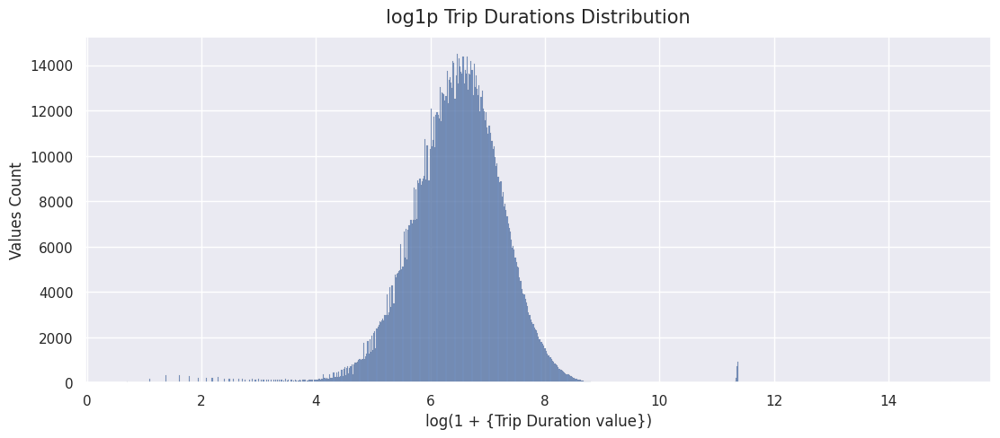

In [33]:
fig = plt.figure(figsize=[13, 5])
ax = fig.add_subplot(111)

# main part
data = df["log_trip_duration"]
sns.histplot(x=data, edgecolor=".5")
#

ax.set_xlabel("log(1 + {Trip Duration value})", fontsize=12)
ax.set_ylabel("Values Count", fontsize=12)
ax.set_title("log1p Trip Durations Distribution", loc='center', fontsize=15, y=1.02)

plt.show()

Получили, что плотность распределения $log(1 + \text{{Trip Duration value}})$ очень похожа на плотность нормального распределения.

Удалим колонку со старым таргетом.

In [34]:
df.drop(columns=["trip_duration"], inplace=True)

In [35]:
df.head()

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,log_trip_duration
0,id2875421,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N,6.122493
1,id2377394,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N,6.498282
2,id3858529,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N,7.661527
3,id3504673,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N,6.063785
4,id2181028,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N,6.077642


Чтобы иметь некоторую точку отсчета, давайте посчитаем значение метрики при наилучшем константном предсказании:

**Решение:**

Доказали выше, что $\text{задача } \text{RMSLE}(X, y, a) \longrightarrow \underset{a}{\min} \text{ эквивалентна задаче } \text{MSE}(X, \hat{y}, \hat{a}) \longrightarrow \underset{\hat{a}}{\min}.$

 Отсюда следует: $\underset{a}{\text{argmin}} \ \text{RMSLE}(X, y, a) = \underset{\hat{a}}{\text{argmin}} \ \text{MSE}(X, \hat{y}, \hat{a}) = \Bigg| \text{ по доказанному ранее (на лекции) факту } \Bigg| = \dfrac{1}{\ell} \sum \limits_{i=1}^{\ell} \hat{y}_i = \\ \dfrac{1}{\ell} \sum \limits_{i=1}^{\ell} \log(1+y_i).$

 Отсюда выборочное среднее по элементам `df["log_trip_duration"]` - искомый аргминимум, а вектор из $ \ \ell \ $ таких выборочных средних - наилучшее константное предсказание.

Посчитаем теперь константное предсказание и значение $\text{RMSLE}$ по нему.

In [36]:
def rmsle(log1p_y_true, log1p_y_pred):
    return np.sqrt(np.sum(np.square(log1p_y_true - log1p_y_pred)) / len(log1p_y_true))

rmsle_best_const = rmsle(df["log_trip_duration"], np.ones(df.shape[0]) * (np.sum(df["log_trip_duration"]) / df.shape[0]))
print(rmsle_best_const)
assert np.allclose(rmsle_best_const, 0.79575, 1e-4)

0.7957592365411509


## Часть 1. Изучаем `pickup_datetime` (2 балла)

**Задание 2 (0.25 баллов)**. Для начала давайте посмотрим, сколько всего было поездок в каждый из дней. Постройте график зависимости количества поездок от дня в году (например, можно воспользоваться `sns.countplot`):

**Решение:**

Из постановки задачи - неочевидно, смотрим ли мы количество поездок независимо от года (день) или с его учётом (дата). Проверим, сколько разных лет в показаниях `df["pickup_datetime"]`.

In [37]:
df["pickup_datetime"].dt.year.unique()

array([2016], dtype=int32)

Год всего один, следовательно, не важно, как рассматривать.

Будем использовать не `sns.countplot` по датам, а groupby по датам и аггрегацией по количеству поездок в ту или иную дату + `sns.barplot`/`ax.bar` (по сути получим то же самое, что получили бы при использовании `sns.countplot`).

Создадим вспомогательную таблицу "День в году - кол-во поездок в этот день".

In [38]:
df_date_to_trips_count = df.groupby(by=df["pickup_datetime"].dt.date).size().reset_index().rename(columns={"pickup_datetime": "date", 0: "trips"})

In [40]:
df_date_to_trips_count

,date,trips
0,2016-01-01,7162
1,2016-01-02,6512
2,2016-01-03,6353
3,2016-01-04,6725
4,2016-01-05,7204
...,...,...
177,2016-06-26,7084
178,2016-06-27,7311
179,2016-06-28,7253
180,2016-06-29,7623


Построим по таблице график:

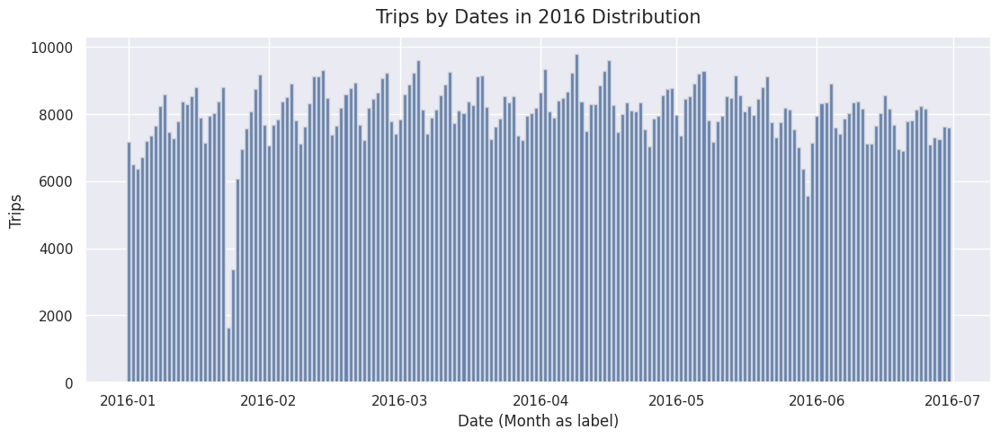

In [41]:
fig = plt.figure(figsize=[13, 5])
ax = fig.add_subplot(111)
ax.bar(df_date_to_trips_count["date"], df_date_to_trips_count["trips"], facecolor='#6082B6', edgecolor="lightgray")
ax.set_xlabel("Date (Month as label)", fontsize=12)
ax.set_ylabel("Trips", fontsize=12)
ax.set_title("Trips by Dates in 2016 Distribution", loc='center', fontsize=15, y=1.02)

plt.show()

**Вопрос**: Вы, вероятно, заметили, что на графике есть 2 периода с аномально маленькими количествами поездок. Вычислите, в какие даты происходили эти скачки вниз и найдите информацию о том, что происходило в эти дни в Нью-Йорке.

Нарисуйте графики зависимости количества поездок от дня недели и от часов в сутках (воспользуйтесь `sns.relplot`):

**Решение:**

На графике видно 2 аномалии.Количество поездок в каждой меньше 6000. Отсюда ищем в `df_date_to_trips_count` даты, когда поездок было меньше 6000.

In [42]:
df_date_to_trips_count.loc[df_date_to_trips_count["trips"] < 6000, "date"]

,date
22,2016-01-23
23,2016-01-24
150,2016-05-30


Первый аномальный период 23-24 января 2016 г. - в это время в Нью-Йорке была сильная метель([тык](https://en.wikipedia.org/wiki/January_2016_United_States_blizzard)), а второй  - 30 мая 2016 г. - Никакой инфомрации по этому поводу в интернете обнаружить не удалось.

Нарисуйте графики зависимости количества поездок от дня недели и от часов в сутках (воспользуйтесь sns.relplot):

**График зависимости кол-ва поездок от дня недели:**

Построим вспомогательную таблицу:

**Решение:**

**График зависимости кол-ва поездок от часа в сутках для разных месяцев:**

Вспомогательная таблица:

**График зависимости кол-ва поездок от часа в сутках для разных дней недели:**

In [43]:
order_by_hour = np.array(df['pickup_datetime'].dt.hour.value_counts().sort_index())
order_by_weekday = np.array(df['pickup_datetime'].dt.weekday.value_counts().sort_index())

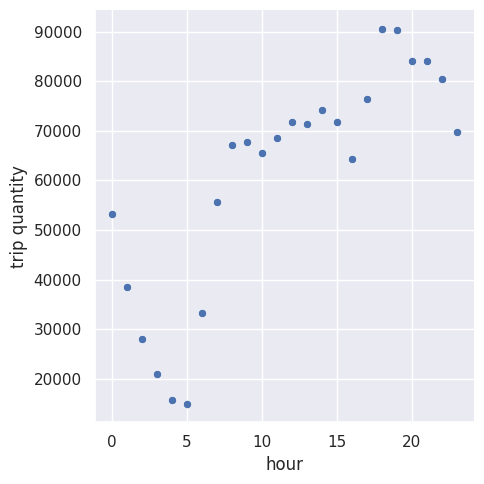

In [44]:
sns.relplot(x=list(range(0, 24)), y=order_by_hour).set(xlabel='hour', ylabel='trip quantity')

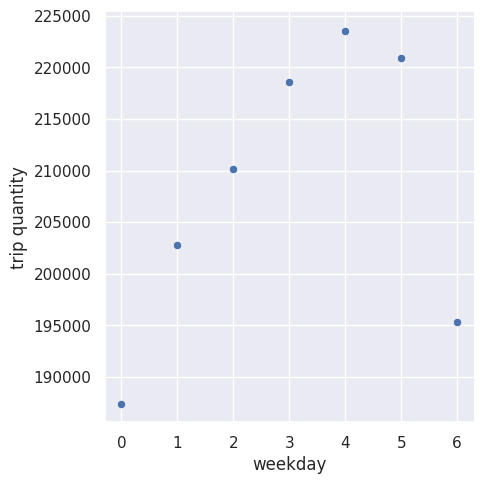

In [45]:
sns.relplot(x=list(range(0, 7)), y=order_by_weekday).set(xlabel='weekday', ylabel='trip quantity')

**Задание 3 (0.5 баллов)**. Нарисуйте на одном графике зависимости количества поездок от часа в сутках для разных месяцев (разные кривые, соответствующие разным месяцам, окрашивайте в разные цвета, воспользуйтесь `hue` в `sns.relplot`). Аналогично нарисуйте зависимости количества поездок от часа в сутках для разных дней недели.

In [46]:
df['month'] = df['pickup_datetime'].dt.month
df['hour'] = df['pickup_datetime'].dt.hour

In [47]:
gk = df.groupby(['month', 'hour'])
gk = gk.agg('size').reset_index().rename(columns={0: 'quantity'})

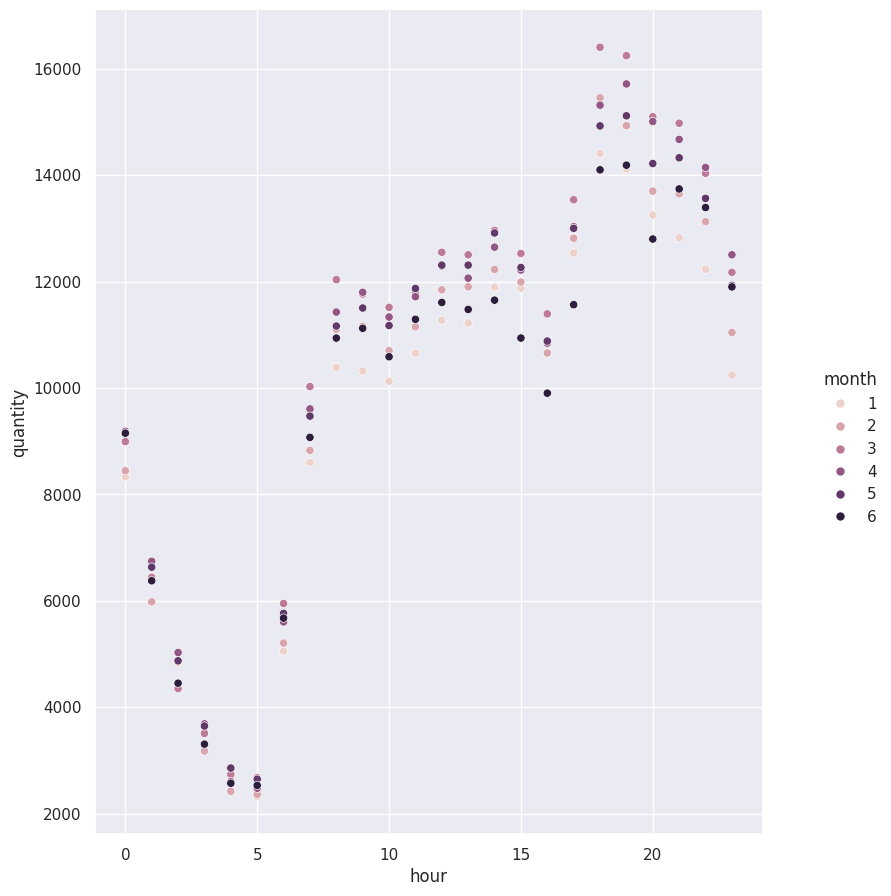

In [48]:
sns.relplot(data=gk, x='hour', y='quantity', hue='month').figure.set_size_inches(10, 10)

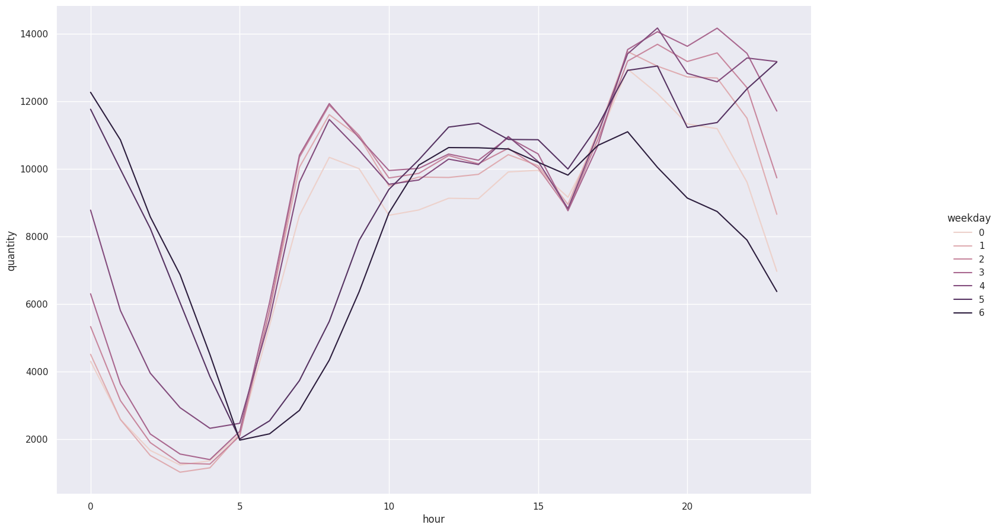

In [49]:
df['weekday'] = df['pickup_datetime'].dt.weekday
gk = df.groupby(['weekday', 'hour'])
gk = gk.agg('size').reset_index().rename(columns={0: 'quantity'})
sns.relplot(data=gk, x='hour', y='quantity', hue='weekday', kind='line').figure.set_size_inches(20, 10)

**Вопрос**: Какие выводы можно сделать, основываясь на графиках выше? Выделяются ли какие-нибудь дни недели? Месяца? Время суток? С чем это связано?

С 3 до 6 утра поездок мало в любые месяцы. В теплое время года больше ночных (2-5 утра) заказов, чем обычно (у многих отпуск или каникулы)
По субботам и воскресеньям ночных заказов очень много (ночная жизнь Нью-Йорка), в будние дни мало и чем ближе к выходным, тем их больше.
В воскресенье вечером мало вечерних заказов, так как следующий день рабочий

**Задание 4 (0.5 баллов)**. Разбейте выборку на обучающую и тестовую в отношении 7:3 (используйте `train_test_split` из `sklearn`). По обучающей выборке нарисуйте график зависимости среднего логарифма времени поездки от дня недели. Затем сделайте то же самое, но для часа в сутках и дня в году.

**Решение:**

In [50]:
from sklearn.model_selection import train_test_split

Разобьём исходную таблицу `df` на `X` - матрицу признаков и `y` - вектор таргетов. Конкретно для этого задания, для построения графиков нам понадобится `"log_trip_duration"` в матрице `X`, поэтому пока не будем удалять `"log_trip_duration"` из `X`, удалим его позже.

In [51]:
X = df.copy(deep=True)
y = df["log_trip_duration"].copy(deep=True)

In [52]:
X.head()

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,log_trip_duration,month,hour,weekday
0,id2875421,2,2016-03-14 17:24:55,1,-73.982155,40.767937,-73.964630,40.765602,N,6.122493,3,17,0
1,id2377394,1,2016-06-12 00:43:35,1,-73.980415,40.738564,-73.999481,40.731152,N,6.498282,6,0,6
2,id3858529,2,2016-01-19 11:35:24,1,-73.979027,40.763939,-74.005333,40.710087,N,7.661527,1,11,1
3,id3504673,2,2016-04-06 19:32:31,1,-74.010040,40.719971,-74.012268,40.706718,N,6.063785,4,19,2
4,id2181028,2,2016-03-26 13:30:55,1,-73.973053,40.793209,-73.972923,40.782520,N,6.077642,3,13,5


In [53]:
y.head()

,log_trip_duration
0,6.122493
1,6.498282
2,7.661527
3,6.063785
4,6.077642


Теперь разобьём выборку на train и test:

In [54]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [55]:
X_train.reset_index(drop=True, inplace=True)
X_test.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)
y_test.reset_index(drop=True, inplace=True)

Теперь построим необходимые нам графики:

**График зависимости среднего логарифма времени поездки от дня недели (train):**

Вспомогательная таблица:

In [56]:
X_train["day_of_week_number"] = X_train["pickup_datetime"].dt.day_of_week # вспомогательная колонка
df_train_days_of_week_to_log_trip_dur_mean = X_train.groupby(by=["day_of_week_number", X_train["pickup_datetime"].dt.day_name()]).agg({"log_trip_duration": "mean"}).reset_index().rename(columns={"pickup_datetime": "day_of_week", "log_trip_duration": "log_trip_duration_mean"}).drop(columns=["day_of_week_number"])

In [57]:
df_train_days_of_week_to_log_trip_dur_mean

,day_of_week,log_trip_duration_mean
0,Monday,6.426763
1,Tuesday,6.492403
2,Wednesday,6.513789
3,Thursday,6.529261
4,Friday,6.498657
5,Saturday,6.420336
6,Sunday,6.376224


In [58]:
X_train.drop(columns=["day_of_week_number"], inplace=True) # удаляем вспомогательную колонку

График:

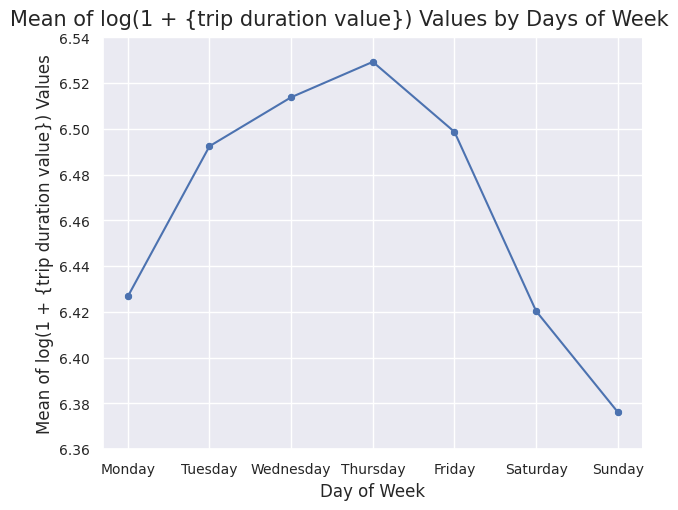

In [60]:

plot = sns.relplot(data=df_train_days_of_week_to_log_trip_dur_mean, x="day_of_week", y="log_trip_duration_mean", kind="line", aspect=1.3)
plot.map(sns.scatterplot, "day_of_week", "log_trip_duration_mean")


plot.set_axis_labels("Day of Week", "Mean of log(1 + {trip duration value}) Values")
plot.fig.suptitle("Mean of log(1 + {trip duration value}) Values by Days of Week", fontsize=15, y=1.02)
plot.axes.flat[0].set_xticks(plot.axes.flat[0].get_xticks())
plot.axes.flat[0].set_xticklabels(fontsize=10, labels=plot.axes.flat[0].get_xticklabels())
plot.axes.flat[0].set_yticks(plot.axes.flat[0].get_yticks())
plot.axes.flat[0].set_yticklabels(fontsize=10, labels=plot.axes.flat[0].get_yticklabels())
plt.show()

**График зависимости среднего логарифма времени поездки от часа в сутках (train):**

Вспомогательная таблица:

In [61]:
df_train_hours_to_log_trip_dur_mean = X_train.groupby(by=X_train["pickup_datetime"].dt.hour).agg({"log_trip_duration": "mean"}).reset_index().rename(columns={"pickup_datetime": "hour", "log_trip_duration": "log_trip_duration_mean"})

In [62]:
df_train_hours_to_log_trip_dur_mean

,hour,log_trip_duration_mean
0,0,6.423411
1,1,6.375272
2,2,6.323034
3,3,6.313351
4,4,6.333394
5,5,6.233975
6,6,6.186678
7,7,6.350414
8,8,6.466131
9,9,6.482851


График:

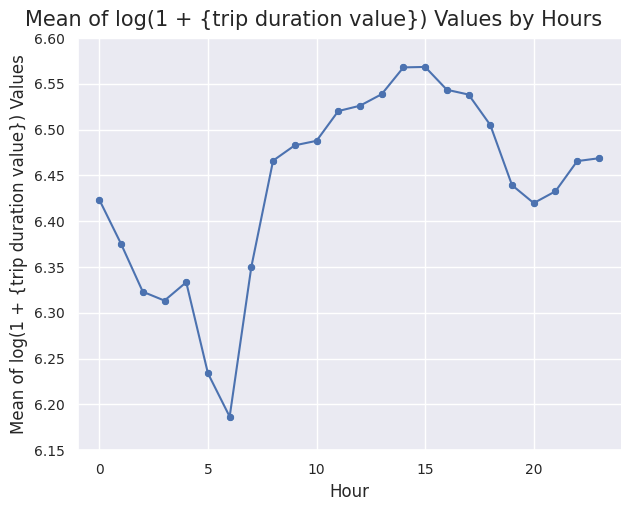

In [63]:
plot = sns.relplot(data=df_train_hours_to_log_trip_dur_mean, x="hour", y="log_trip_duration_mean", kind="line", aspect=1.3)
plot.map(sns.scatterplot, "hour", "log_trip_duration_mean")

plot.set_axis_labels("Hour", "Mean of log(1 + {trip duration value}) Values")
plot.fig.suptitle("Mean of log(1 + {trip duration value}) Values by Hours", fontsize=15, y=1.02)
plot.axes.flat[0].set_xlim([-1, 24])
plot.axes.flat[0].set_xticks(plot.axes.flat[0].get_xticks()[1:-1])
plot.axes.flat[0].set_xticklabels(fontsize=10, labels=plot.axes.flat[0].get_xticklabels())
plot.axes.flat[0].set_yticks(plot.axes.flat[0].get_yticks())
plot.axes.flat[0].set_yticklabels(fontsize=10, labels=plot.axes.flat[0].get_yticklabels())
plt.show()

**График зависимости среднего логарифма времени поездки от дня в году (train):**

Вспомогательная таблица:

In [64]:
df_train_days_to_log_trip_dur_mean = X_train.groupby(by=X_train["pickup_datetime"].dt.date).agg({"log_trip_duration": "mean"}).reset_index().rename(columns={"pickup_datetime": "day", "log_trip_duration": "log_trip_duration_mean"})

In [65]:
df_train_days_to_log_trip_dur_mean

,day,log_trip_duration_mean
0,2016-01-01,6.336530
1,2016-01-02,6.310629
2,2016-01-03,6.327419
3,2016-01-04,6.307745
4,2016-01-05,6.363087
...,...,...
177,2016-06-26,6.454265
178,2016-06-27,6.480539
179,2016-06-28,6.491671
180,2016-06-29,6.540048


График:

In [66]:
import matplotlib.dates as mdates

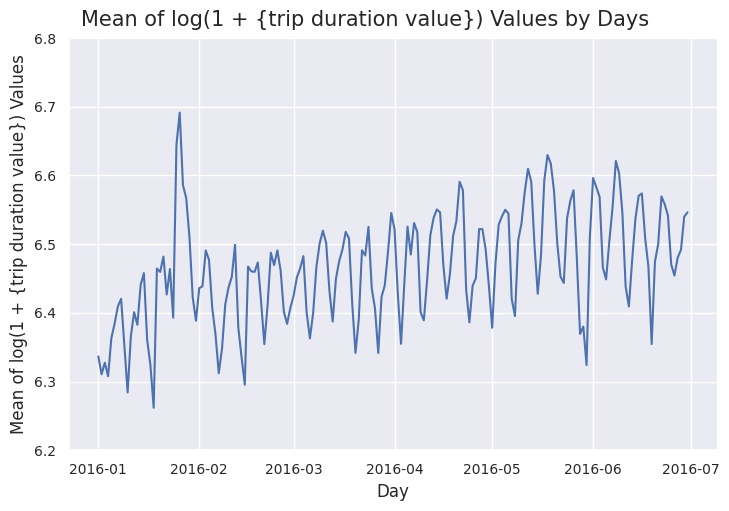

In [67]:
plot = sns.relplot(data=df_train_days_to_log_trip_dur_mean, x="day", y="log_trip_duration_mean", kind="line", aspect=1.5)

plot.set_axis_labels("Day", "Mean of log(1 + {trip duration value}) Values")
plot.fig.suptitle("Mean of log(1 + {trip duration value}) Values by Days", fontsize=15, y=1.02)
plot.axes.flat[0].set_xticks(plot.axes.flat[0].get_xticks())
plot.axes.flat[0].set_xticklabels(fontsize=10, labels=plot.axes.flat[0].get_xticklabels())
plot.axes.flat[0].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m')) # конвертим записи вида Y-m-d в лейблах оси Ox в записи вида Y-m
plot.axes.flat[0].set_yticks(plot.axes.flat[0].get_yticks())
plot.axes.flat[0].set_yticklabels(fontsize=10, labels=plot.axes.flat[0].get_yticklabels())
plt.show()

**Вопрос**: Похожи ли графики зависимости таргета от дня недели и от часа в сутках на аналогичные графики для количества поездок? Почему? Что происходит со средним таргетом в те два аномальных периода, что мы видели выше? Почему так происходит? Наблюдаете ли вы какой-нибудь тренд на графике зависимости `log_trip_duration` от номера дня в году?

**Ответ:**

1).
- Графики зависимости от дней недели похожи общим поведением кривой - от начала недели к концу рабочей недели и кол-во поездок, и их длительность растут, а на выходных оба параметра уменьшаются. С другой стороны, при более детальном взгляде на графики видно, что глобальные максимумы достигаются в разные дни: по кол-ву поездок - в пятницу, а по их логарифмированной длительности - в четверг; также различаются и темпы роста/спада этих параметров на графиках. Из-за этих отличий и из-за того, что зависимость между средней длительностью поездок и их количеством достаточно неочевидна, несмотря на похожее поведение кривых, существующих данных недостаточно для объяснения тренда.  

- Графики зависимости от часов в сутках похожи тем, что ранним утром (с 0 до 6 часов) оба значения зависимых от часов переменных резко падают и достигают минимума, а во всё остальное время оба показателя гораздо выше, чем ранним утром. Эту корреляцию можно объяснить тем, что ранним утром трафик ниже => чем меньше поездок совершается в городе, тем быстрее эти поездки проходят из-за отсутствия пробок, и наоборот, в остальное время трафик выше => совершается больше поездок одновременно => выше вероятность пробок, и поездки становятся дольше. В остальном эти графики отличаются.

2).

- Из графика зависимости средней логарифмированной длительности поездки от дня в году можно определить, что 23-24 января средняя лог-длительность поездки резко выросла и достигла своего глобального максимума за рассматриваемые полгода. Это можно объяснить тем, что метель, случившаяся в этот период, вызвала сильные пробки в городе.

- Также из этого графика можно видеть, что 30 мая (второй аномальный период) - было резкое снижение средней лог-длительности поездки, при этом глобальный минимум за полгода достигнут не был. Здесь сложно как-то это объяснить, потому что непонятно, что случилось 30 мая 2016 г. в Нью-Йорке.

3).

- На графике зависимости средней лог-длительности поездки от дня в году действительно можно выделить возрастающий тренд, если отбросить недельную периодичность.

Добавьте следующие признаки на основе `pickup_datetime`:
1. День недели
2. Месяц
3. Час
4. Является ли период аномальным (два бинарных признака, соответствующие двум аномальным периодам)
5. Номер дня в году

In [68]:
X_train["day_of_week"] = X_train["pickup_datetime"].dt.day_of_week # день недели
X_train["month"] = X_train["pickup_datetime"].dt.month # месяц
X_train["hour"] = X_train["pickup_datetime"].dt.hour # час
X_train["is_anomaly_1"] = ((X_train["pickup_datetime"].dt.month == 1) & (X_train["pickup_datetime"].dt.day.isin([23, 24]))) # была ли поездка в аномальный период 1 (23-24 января)
X_train["is_anomaly_2"] = ((X_train["pickup_datetime"].dt.month == 5) & (X_train["pickup_datetime"].dt.day == 30)) # была ли поездка в аномальный период 2 (30 мая)
X_train["day"] = X_train["pickup_datetime"].dt.day_of_year # номер дня в году

In [69]:
X_train

,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,log_trip_duration,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day
0,id2209155,2,2016-05-03 09:03:08,2,-73.979813,40.752529,-73.982681,40.763680,N,6.739337,5,9,1,1,False,False,124
1,id0586605,1,2016-01-01 16:40:51,1,-73.977623,40.746296,-73.968414,40.788933,N,6.909753,1,16,4,4,False,False,1
2,id0467144,1,2016-04-24 13:57:03,1,-73.950699,40.779404,-73.863129,40.768608,N,6.955593,4,13,6,6,False,False,115
3,id0989010,2,2016-01-10 17:03:47,1,-73.984558,40.721802,-73.976753,40.752213,N,6.665684,1,17,6,6,False,False,10
4,id0580742,1,2016-02-25 17:37:36,1,-73.967720,40.768742,-73.977173,40.789875,N,6.597146,2,17,3,3,False,False,56
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1021045,id1753868,2,2016-03-25 07:11:49,2,-73.955032,40.777328,-74.006203,40.749424,N,7.156177,3,7,4,4,False,False,85
1021046,id2204747,1,2016-02-16 18:01:45,1,-73.973618,40.763920,-73.983849,40.749874,N,6.726233,2,18,1,1,False,False,47
1021047,id3043606,2,2016-01-26 19:22:29,1,-74.006195,40.734283,-73.949608,40.785282,N,7.159292,1,19,1,1,False,False,26
1021048,id1458584,1,2016-01-19 11:53:47,1,-73.962341,40.767323,-73.969757,40.768669,N,5.966147,1,11,1,1,False,False,19


Итак, мы уже создали некоторое количество признаков.

**Вопрос**: Какие из признаков _стоит рассматривать в этой задаче_   как категориальные, а какие - как численные? Почему?

**Ответ:**

store_and_fwd_flag, is_blizzard, is_heat - категориальные \\
number_of_day, weekday, hour, month, длительность поездок, координаты и тд - численные

**Задание 5 (0.75 баллов)**. Обучите `Ridge`-регрессию с параметрами по умолчанию, закодировав все категориальные признаки с помощью `OneHotEncoder`. Численные признаки отмасштабируйте с помощью `StandardScaler`. Используйте только признаки, которые мы выделили в этой части задания.

Выкинем таргет и неиспользуемые признаки из `X_train`:

In [70]:
X_train.columns

Index(['id', 'vendor_id', 'pickup_datetime', 'passenger_count',
       'pickup_longitude', 'pickup_latitude', 'dropoff_longitude',
       'dropoff_latitude', 'store_and_fwd_flag', 'log_trip_duration', 'month',
       'hour', 'weekday', 'day_of_week', 'is_anomaly_1', 'is_anomaly_2',
       'day'],
      dtype='object')

In [71]:
columns_to_drop = ['log_trip_duration', 'store_and_fwd_flag', 'id', 'vendor_id',
                   'pickup_datetime', 'passenger_count', 'pickup_longitude',
                   'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude']

X_train_dropped = X_train[columns_to_drop] # сохраняем те колонки, что собираемся дропать, для будущих заданий

X_train.drop(columns=columns_to_drop, inplace=True)

In [72]:
X_train

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day
0,5,9,1,1,False,False,124
1,1,16,4,4,False,False,1
2,4,13,6,6,False,False,115
3,1,17,6,6,False,False,10
4,2,17,3,3,False,False,56
...,...,...,...,...,...,...,...
1021045,3,7,4,4,False,False,85
1021046,2,18,1,1,False,False,47
1021047,1,19,1,1,False,False,26
1021048,1,11,1,1,False,False,19


Аналогично `X_train` подготовим данные в `X_test`.

In [73]:
X_test["day_of_week"] = X_test["pickup_datetime"].dt.day_of_week # день недели
X_test["month"] = X_test["pickup_datetime"].dt.month # месяц
X_test["hour"] = X_test["pickup_datetime"].dt.hour # час
X_test["is_anomaly_1"] = ((X_test["pickup_datetime"].dt.month == 1) & (X_test["pickup_datetime"].dt.day.isin([23, 24]))) # была ли поездка в аномальный период 1 (23-24 января)
X_test["is_anomaly_2"] = ((X_test["pickup_datetime"].dt.month == 5) & (X_test["pickup_datetime"].dt.day == 30)) # была ли поездка в аномальный период 2 (30 мая)
X_test["day"] = X_test["pickup_datetime"].dt.day_of_year # номер дня в году

In [74]:
columns_to_drop = ['log_trip_duration', 'store_and_fwd_flag', 'id', 'vendor_id',
                   'pickup_datetime', 'passenger_count', 'pickup_longitude',
                   'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude']

X_test_dropped = X_test[columns_to_drop] # сохраняем те колонки, что собираемся дропать, для будущих заданий

X_test.drop(columns=columns_to_drop, inplace=True)

In [75]:
X_test

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day
0,6,7,2,2,False,False,160
1,4,12,6,6,False,False,94
2,6,2,6,6,False,False,157
3,5,17,3,3,False,False,126
4,5,17,3,3,False,False,133
...,...,...,...,...,...,...,...
437589,5,17,2,2,False,False,146
437590,6,11,5,5,False,False,163
437591,5,6,4,4,False,False,141
437592,3,22,6,6,False,False,66


Пересчитаем $\text{RMSLE}$ для наилучшей константы для `y_test` (она другая, так как берём только часть значений из `df` здесь, а не все, как в 0 части) (чтобы сравнить с этим значением получившееся значение ошибки).

In [76]:
rmsle_best_const = rmsle(y_test, np.ones(y_test.shape[0]) * (np.sum(y_test) / y_test.shape[0]))
print("Best_const_RMSLE =", rmsle_best_const)

Best_const_RMSLE = 0.7950269011472101


Делаем долгожданный fit-predict (модель, обученная по I варианту (см. последний вопрос задания 4)).

In [77]:
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

In [78]:
categorical_features = ['day_of_week', 'month', 'hour', 'is_anomaly_1', 'is_anomaly_2']
numeric_features = ['day']

column_transformer = ColumnTransformer([
    ('ohe', OneHotEncoder(), categorical_features),
    ('scaling', StandardScaler(), numeric_features)
])

pipeline = Pipeline(steps=[
    ('ohe_and_scaling', column_transformer),
    ('regression', Ridge())
])

model = pipeline.fit(X_train, y_train)
y_pred = model.predict(X_test)

print("Best_const_RMSLE =", rmsle_best_const)
print("Test_RMSLE =", rmsle(y_test, y_pred))

Best_const_RMSLE = 0.7950269011472101
Test_RMSLE = 0.7881777174125214


Наше предсказание даёт ошибку меньше, чем у наилучшей константы => всё ок.

Делаем fit-predict (модель, обученная по II варианту (см. последний вопрос задания 4)).

In [79]:
categorical_features = ['day_of_week', 'month', 'hour', 'is_anomaly_1', 'is_anomaly_2', 'day']
numeric_features = []

column_transformer = ColumnTransformer([
    ('ohe', OneHotEncoder(), categorical_features),
    ('scaling', StandardScaler(), numeric_features)
])

pipeline = Pipeline(steps=[
    ('ohe_and_scaling', column_transformer),
    ('regression', Ridge())
])

model = pipeline.fit(X_train, y_train)
y_pred = model.predict(X_test)

print("Best_const_RMSLE =", rmsle_best_const)
print("Test_RMSLE =", rmsle(y_test, y_pred))

Best_const_RMSLE = 0.7950269011472101
Test_RMSLE = 0.7871298107764214


Наше предсказание даёт ошибку меньше, чем у наилучшей константы => всё ок.

Отсюда ответ на последний вопрос в задании 4: стоит брать все новые признаки как категориальные, так как таким образом достигаем меньшей ошибки, чем если при I варианте (день - не категориальный признак).

## Часть 2. Изучаем координаты (3 балла)
Мы уже очень хорошо изучили данные о времени начала поездки, давайте теперь посмотрим на информацию о координатах начала и конца поездки. Мы подготовили для вас функцию, которая на карте рисует точки начала или конца поездки. Примеры ее вызова вы найдете ниже. Обратите внимание, что в эту функцию мы передаем лишь небольшой кусочек данных, посколько иначе функция будет работать очень долго

In [80]:
def show_circles_on_map(data, latitude_column, longitude_column, color):
    """
    The function draws map with circles on it.
    The center of the map is the mean of coordinates passed in data.

    data: DataFrame that contains columns latitude_column and longitude_column
    latitude_column: string, the name of column for latitude coordinates
    longitude_column: string, the name of column for longitude coordinates
    color: string, the color of circles to be drawn
    """

    location = (data[latitude_column].mean(), data[longitude_column].mean())
    m = folium.Map(location=location)

    for _, row in data.iterrows():
        folium.Circle(
            radius=100,
            location=(row[latitude_column], row[longitude_column]),
            color=color,
            fill_color=color,
            fill=True
        ).add_to(m)

    return m

In [81]:
show_circles_on_map(df.sample(1000), "pickup_latitude", "pickup_longitude", "blue")

In [82]:
show_circles_on_map(df.sample(1000), "dropoff_latitude", "dropoff_longitude", "blue")

**Вопрос**: Какие пункты (или скопления точек, в количестве 2-3), по вашему мнению, выделяются на карте от основной массы и могут быть полезны для нашей задачи? Почему вы их выбрали? В чём особенность этих скоплений точек для нашей задачи?

**Ответ:**
- Основная масса точек на карте - Нижний Манхэттен, в котором находится большинство бизнес-точек, ресторанов и т.п., и густонаселённые районы, такие, как Маленькая Италия и Чайнатаун.

- Помимо основной массы точек особо выделяются следующие два аэропорта:
    - JFK International Airport
    - LaGuardia International Airport.

- Эти два пункта полезны для решения задачи, так как аэропорты создают аномально высокий трафик такси со специфическим по длительности маршрутом: поездки по городу скорее будут короче по расстоянию, чем от аэропорта, который находится на удалении от центра города, в город (и наоборот, от города в аэропорт).

**Задание 6 (0.75 балл)**. Как мы все прекрасно помним, $t = s / v_{\text{ср}}$, поэтому очевидно, что самым сильным признаком будет расстояние, которое необходимо проехать. Мы не можем посчитать точное расстояние, которое необходимо преодолеть такси, но мы можем его оценить, посчитав кратчайшее расстояние между точками начала и конца поездки. Чтобы корректно посчитать расстояние между двумя точками на Земле, можно использовать функцию `haversine`. Также можно воспользоваться кодом с первого семинара. Посчитайте кратчайшее расстояние для объектов и запишите его в колонку `haversine`:

**Решение:**

Вернём все дропнутые колонки обратно в `X_train` и в `X_test`.

In [83]:
X_train = pd.concat([X_train, X_train_dropped], axis=1)
X_test = pd.concat([X_test, X_test_dropped], axis=1)

In [84]:
X_train.head()

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,log_trip_duration,store_and_fwd_flag,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude
0,5,9,1,1,False,False,124,6.739337,N,id2209155,2,2016-05-03 09:03:08,2,-73.979813,40.752529,-73.982681,40.763680
1,1,16,4,4,False,False,1,6.909753,N,id0586605,1,2016-01-01 16:40:51,1,-73.977623,40.746296,-73.968414,40.788933
2,4,13,6,6,False,False,115,6.955593,N,id0467144,1,2016-04-24 13:57:03,1,-73.950699,40.779404,-73.863129,40.768608
3,1,17,6,6,False,False,10,6.665684,N,id0989010,2,2016-01-10 17:03:47,1,-73.984558,40.721802,-73.976753,40.752213
4,2,17,3,3,False,False,56,6.597146,N,id0580742,1,2016-02-25 17:37:36,1,-73.967720,40.768742,-73.977173,40.789875


In [85]:
X_test.head()

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,log_trip_duration,store_and_fwd_flag,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude
0,6,7,2,2,False,False,160,6.947937,N,id2793718,2,2016-06-08 07:36:19,1,-73.985611,40.735943,-73.980331,40.760468
1,4,12,6,6,False,False,94,6.719013,N,id3485529,2,2016-04-03 12:58:11,1,-73.978394,40.764351,-73.991623,40.749859
2,6,2,6,6,False,False,157,6.421622,N,id1816614,2,2016-06-05 02:49:13,5,-73.989059,40.744389,-73.973381,40.748692
3,5,17,3,3,False,False,126,6.766192,N,id1050851,2,2016-05-05 17:18:27,2,-73.990326,40.731136,-73.991264,40.748917
4,5,17,3,3,False,False,133,8.510773,N,id0140657,1,2016-05-12 17:43:38,4,-73.789497,40.646675,-73.987137,40.759232


Посчитаем кратчайшее расстояние для каждого объектов для `X_train` и для `X_test`.

Функция для подсчёта кратчайшего расстояния между двумя точками (взята с 1 семинара):

In [86]:
def haversine(lat1, lng1, lat2, lng2):
    lat1, lng1, lat2, lng2 = map(np.radians, (lat1, lng1, lat2, lng2))
    AVG_EARTH_RADIUS = 6371  # in km
    lat = lat2 - lat1
    lng = lng2 - lng1
    d = np.sin(lat * 0.5) ** 2 + np.cos(lat1) * np.cos(lat2) * np.sin(lng * 0.5) ** 2
    h = 2 * AVG_EARTH_RADIUS * np.arcsin(np.sqrt(d))
    return h

Применяем её:

In [87]:
X_train.columns

Index(['month', 'hour', 'weekday', 'day_of_week', 'is_anomaly_1',
       'is_anomaly_2', 'day', 'log_trip_duration', 'store_and_fwd_flag', 'id',
       'vendor_id', 'pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude'],
      dtype='object')

In [88]:
X_train["haversine"] = haversine(X_train["pickup_latitude"], X_train["pickup_longitude"], X_train["dropoff_latitude"], X_train["dropoff_longitude"])

In [89]:
X_train

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,log_trip_duration,store_and_fwd_flag,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,haversine
0,5,9,1,1,False,False,124,6.739337,N,id2209155,2,2016-05-03 09:03:08,2,-73.979813,40.752529,-73.982681,40.763680,1.263187
1,1,16,4,4,False,False,1,6.909753,N,id0586605,1,2016-01-01 16:40:51,1,-73.977623,40.746296,-73.968414,40.788933,4.804012
2,4,13,6,6,False,False,115,6.955593,N,id0467144,1,2016-04-24 13:57:03,1,-73.950699,40.779404,-73.863129,40.768608,7.471088
3,1,17,6,6,False,False,10,6.665684,N,id0989010,2,2016-01-10 17:03:47,1,-73.984558,40.721802,-73.976753,40.752213,3.444869
4,2,17,3,3,False,False,56,6.597146,N,id0580742,1,2016-02-25 17:37:36,1,-73.967720,40.768742,-73.977173,40.789875,2.481063
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1021045,3,7,4,4,False,False,85,7.156177,N,id1753868,2,2016-03-25 07:11:49,2,-73.955032,40.777328,-74.006203,40.749424,5.310383
1021046,2,18,1,1,False,False,47,6.726233,N,id2204747,1,2016-02-16 18:01:45,1,-73.973618,40.763920,-73.983849,40.749874,1.783777
1021047,1,19,1,1,False,False,26,7.159292,N,id3043606,2,2016-01-26 19:22:29,1,-74.006195,40.734283,-73.949608,40.785282,7.407646
1021048,1,11,1,1,False,False,19,5.966147,N,id1458584,1,2016-01-19 11:53:47,1,-73.962341,40.767323,-73.969757,40.768669,0.642215


In [90]:
X_test["haversine"] = haversine(X_test["pickup_latitude"], X_test["pickup_longitude"], X_test["dropoff_latitude"], X_test["dropoff_longitude"])

In [91]:
X_test

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,log_trip_duration,store_and_fwd_flag,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,haversine
0,6,7,2,2,False,False,160,6.947937,N,id2793718,2,2016-06-08 07:36:19,1,-73.985611,40.735943,-73.980331,40.760468,2.763050
1,4,12,6,6,False,False,94,6.719013,N,id3485529,2,2016-04-03 12:58:11,1,-73.978394,40.764351,-73.991623,40.749859,1.959178
2,6,2,6,6,False,False,157,6.421622,N,id1816614,2,2016-06-05 02:49:13,5,-73.989059,40.744389,-73.973381,40.748692,1.404772
3,5,17,3,3,False,False,126,6.766192,N,id1050851,2,2016-05-05 17:18:27,2,-73.990326,40.731136,-73.991264,40.748917,1.978660
4,5,17,3,3,False,False,133,8.510773,N,id0140657,1,2016-05-12 17:43:38,4,-73.789497,40.646675,-73.987137,40.759232,20.837745
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
437589,5,17,2,2,False,False,146,6.717805,N,id2411525,1,2016-05-25 17:07:59,2,-73.983505,40.766369,-73.984795,40.785965,2.181690
437590,6,11,5,5,False,False,163,6.163315,N,id3782154,1,2016-06-11 11:18:45,1,-73.968147,40.800476,-73.953979,40.787643,1.859722
437591,5,6,4,4,False,False,141,6.171701,N,id0699942,2,2016-05-20 06:30:38,5,-74.006210,40.733158,-73.997932,40.722610,1.364597
437592,3,22,6,6,False,False,66,7.038784,N,id3422152,1,2016-03-06 22:37:19,2,-73.990089,40.728859,-73.991234,40.765404,4.064740


Так как мы предсказываем логарифм времени поездки и хотим, чтобы наши признаки были линейно зависимы с этой целевой переменной, нам нужно логарифмировать расстояние: $\log t = \log s - \log{v_{\text{ср}}}$. Запишите логарифм `haversine` в отдельную колонку `log_haversine`:

Заметим, что есть небольшая доля поездок из некоторой точки в неё же (признак этого - расстояние, равное нулю):

In [92]:
X_test.loc[X_test["haversine"] == 0, :].shape[0] + X_train.loc[X_train["haversine"] == 0, :].shape[0]

5897

Отсюда следует, что нам нужен не просто логарифм, а $\log(1 + {\text{haversine}})$.

In [93]:
X_train["log_haversine"] = np.log1p(X_train["haversine"])
X_test["log_haversine"] = np.log1p(X_test["haversine"])

In [94]:
X_train.head()

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,log_trip_duration,store_and_fwd_flag,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,haversine,log_haversine
0,5,9,1,1,False,False,124,6.739337,N,id2209155,2,2016-05-03 09:03:08,2,-73.979813,40.752529,-73.982681,40.763680,1.263187,0.816774
1,1,16,4,4,False,False,1,6.909753,N,id0586605,1,2016-01-01 16:40:51,1,-73.977623,40.746296,-73.968414,40.788933,4.804012,1.758549
2,4,13,6,6,False,False,115,6.955593,N,id0467144,1,2016-04-24 13:57:03,1,-73.950699,40.779404,-73.863129,40.768608,7.471088,2.136659
3,1,17,6,6,False,False,10,6.665684,N,id0989010,2,2016-01-10 17:03:47,1,-73.984558,40.721802,-73.976753,40.752213,3.444869,1.491750
4,2,17,3,3,False,False,56,6.597146,N,id0580742,1,2016-02-25 17:37:36,1,-73.967720,40.768742,-73.977173,40.789875,2.481063,1.247338


In [95]:
X_test.head()

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,log_trip_duration,store_and_fwd_flag,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,haversine,log_haversine
0,6,7,2,2,False,False,160,6.947937,N,id2793718,2,2016-06-08 07:36:19,1,-73.985611,40.735943,-73.980331,40.760468,2.763050,1.325230
1,4,12,6,6,False,False,94,6.719013,N,id3485529,2,2016-04-03 12:58:11,1,-73.978394,40.764351,-73.991623,40.749859,1.959178,1.084912
2,6,2,6,6,False,False,157,6.421622,N,id1816614,2,2016-06-05 02:49:13,5,-73.989059,40.744389,-73.973381,40.748692,1.404772,0.877455
3,5,17,3,3,False,False,126,6.766192,N,id1050851,2,2016-05-05 17:18:27,2,-73.990326,40.731136,-73.991264,40.748917,1.978660,1.091473
4,5,17,3,3,False,False,133,8.510773,N,id0140657,1,2016-05-12 17:43:38,4,-73.789497,40.646675,-73.987137,40.759232,20.837745,3.083640


Убедимся, что логарифм расстояния лучше коррелирует с нашим таргетом, чем просто расстояние:

Для ассерта, проводящегося по всем данным, объединим `X_train` и `X_test` в единую таблицу `df_mod`.

In [96]:
df_mod = pd.concat([X_train, X_test], ignore_index=True)

In [97]:
df_mod

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,log_trip_duration,store_and_fwd_flag,id,vendor_id,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,haversine,log_haversine
0,5,9,1,1,False,False,124,6.739337,N,id2209155,2,2016-05-03 09:03:08,2,-73.979813,40.752529,-73.982681,40.763680,1.263187,0.816774
1,1,16,4,4,False,False,1,6.909753,N,id0586605,1,2016-01-01 16:40:51,1,-73.977623,40.746296,-73.968414,40.788933,4.804012,1.758549
2,4,13,6,6,False,False,115,6.955593,N,id0467144,1,2016-04-24 13:57:03,1,-73.950699,40.779404,-73.863129,40.768608,7.471088,2.136659
3,1,17,6,6,False,False,10,6.665684,N,id0989010,2,2016-01-10 17:03:47,1,-73.984558,40.721802,-73.976753,40.752213,3.444869,1.491750
4,2,17,3,3,False,False,56,6.597146,N,id0580742,1,2016-02-25 17:37:36,1,-73.967720,40.768742,-73.977173,40.789875,2.481063,1.247338
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1458639,5,17,2,2,False,False,146,6.717805,N,id2411525,1,2016-05-25 17:07:59,2,-73.983505,40.766369,-73.984795,40.785965,2.181690,1.157413
1458640,6,11,5,5,False,False,163,6.163315,N,id3782154,1,2016-06-11 11:18:45,1,-73.968147,40.800476,-73.953979,40.787643,1.859722,1.050724
1458641,5,6,4,4,False,False,141,6.171701,N,id0699942,2,2016-05-20 06:30:38,5,-74.006210,40.733158,-73.997932,40.722610,1.364597,0.860608
1458642,3,22,6,6,False,False,66,7.038784,N,id3422152,1,2016-03-06 22:37:19,2,-73.990089,40.728859,-73.991234,40.765404,4.064740,1.622303


In [98]:
your_df = df_mod
assert your_df['log_haversine'].corr(your_df['log_trip_duration']) > your_df['haversine'].corr(your_df['log_trip_duration'])

Действительно, лог-расстояние лучше коррелирует с таргетом, чем просто расстояние.

**Задание 7 (0.75 балла)**. Давайте изучим среднюю скорость движения такси. Посчитайте среднюю скорость для каждого объекта обучающей выборки, разделив `haversine` на `trip_duration`, и нарисуйте гистограмму ее распределения

Создадим колонку `avg_speed` со средней скоростью движения такси в `X_train`.

In [99]:
X_train["trip_duration"] = np.expm1(X_train["log_trip_duration"])
X_train["avg_speed"] = X_train["haversine"] / X_train["trip_duration"]

In [100]:
X_train.head()

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,log_trip_duration,store_and_fwd_flag,id,...,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,haversine,log_haversine,trip_duration,avg_speed
0,5,9,1,1,False,False,124,6.739337,N,id2209155,...,2016-05-03 09:03:08,2,-73.979813,40.752529,-73.982681,40.763680,1.263187,0.816774,844.0,0.001497
1,1,16,4,4,False,False,1,6.909753,N,id0586605,...,2016-01-01 16:40:51,1,-73.977623,40.746296,-73.968414,40.788933,4.804012,1.758549,1001.0,0.004799
2,4,13,6,6,False,False,115,6.955593,N,id0467144,...,2016-04-24 13:57:03,1,-73.950699,40.779404,-73.863129,40.768608,7.471088,2.136659,1048.0,0.007129
3,1,17,6,6,False,False,10,6.665684,N,id0989010,...,2016-01-10 17:03:47,1,-73.984558,40.721802,-73.976753,40.752213,3.444869,1.491750,784.0,0.004394
4,2,17,3,3,False,False,56,6.597146,N,id0580742,...,2016-02-25 17:37:36,1,-73.967720,40.768742,-73.977173,40.789875,2.481063,1.247338,732.0,0.003389


Построим теперь гистограмму распределения средней скорости для объектов `X_train`:

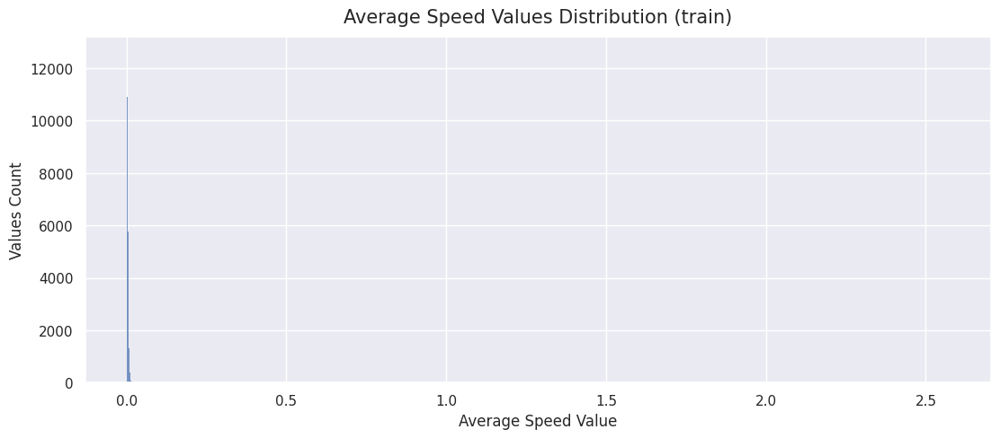

In [102]:
fig = plt.figure(figsize=[13, 5])
ax = fig.add_subplot(111)

data = X_train["avg_speed"]
sns.histplot(x=data, edgecolor=".5")

ax.set_xlabel("Average Speed Value", fontsize=12)
ax.set_ylabel("Values Count", fontsize=12)
ax.set_title("Average Speed Values Distribution (train)", loc='center', fontsize=15, y=1.02)

plt.show()

Как можно видеть по гистограмме, для некоторых объектов у нас получились очень больше значения скоростей. Нарисуйте гистограмму по объектам, для которых значение скорости получилось разумным (например, можно не включать рассмотрение объекты, где скорость больше некоторой квантили):

Посмотрим на значения средней скорости, отсортированные по возрастанию. Ищем очевидные выбросы.

In [103]:
data = X_train["avg_speed"].copy(deep=True)
data.sort_values(inplace=True, ignore_index=True)

In [104]:
data

,avg_speed
0,0.000000
1,0.000000
2,0.000000
3,0.000000
4,0.000000
...,...
1021045,0.487933
1021046,1.135198
1021047,1.458616
1021048,1.566804


Посмотрим на хвост:

In [105]:
data.tail(20)

,avg_speed
1021030,0.175964
1021031,0.190298
1021032,0.211390
1021033,0.231459
1021034,0.252601
1021035,0.257435
1021036,0.263580
1021037,0.304295
1021038,0.316373
1021039,0.345577


Как можно заметить, значения, начиная с индекса `1021046` и до конца таблицы, значительно превышают все предшествующие => их можно считать выбросами и не рассматривать (заметим, что все значения до `1021046`-го меньше 1, а последние 4 значения, начиная с `1021046`, - больше; так мы сможем отделить эти выбросы от остальных значений).

Также можно заметить, что минимальная средняя скорость равна нулю, что означает, что кратчайшая длина пути была равна нулю, а время - больше нуля. Вообще говоря, это странно (можно попытаться объяснить это тем, что это могло быть ожидание таксистом пассажира, отказ таксиста от поездки, неправильно определённая точка начала/конца поездки и т.п.), но оставим эти данные, так как их достаточно много => это может дать нам информацию о некотором тренде (см. след. блок кода). Остальные значения в начале массива больше нуля и не очень большие (как последние 4 поездки в отсортированном массиве значений средних скоростей) => оставляем их.  

In [106]:
len(X_train[X_train["avg_speed"] == 0]) # кол-во объектов с нулевой средней скоростью

4110

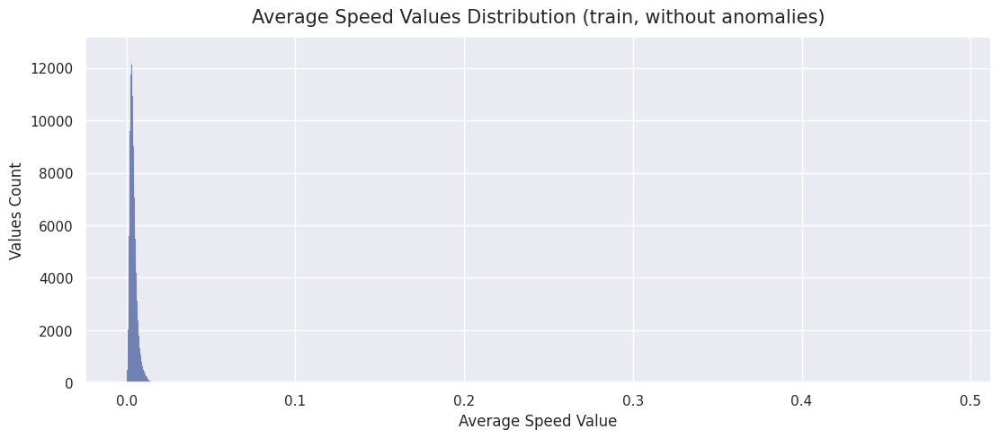

In [107]:
fig = plt.figure(figsize=[13, 5])
ax = fig.add_subplot(111)

# main part
threshold = 1
data = X_train.loc[X_train["avg_speed"] < threshold, "avg_speed"]
sns.histplot(x=data, edgecolor=".5")
#

ax.set_xlabel("Average Speed Value", fontsize=12)
ax.set_ylabel("Values Count", fontsize=12)
ax.set_title("Average Speed Values Distribution (train, without anomalies)", loc='center', fontsize=15, y=1.02)

plt.show()

Для каждой пары (день недели, час суток) посчитайте медиану скоростей. Нарисуйте с помощью `sns.heatmap` график, где по осям будут дни недели и часы, а в качестве значения функции - медиана скорости

**Решение:**

Вспомогательная таблица:

In [108]:
df_train_days_of_week_and_hours_to_speed_medians = X_train.groupby(by=[X_train["pickup_datetime"].dt.day_name(), 'hour']).agg({'avg_speed': 'median'}).reset_index().rename(columns={"pickup_datetime": "day_of_week", "avg_speed": "speed_median"})

In [109]:
df_train_days_of_week_and_hours_to_speed_medians

,day_of_week,hour,speed_median
0,Friday,0,0.004445
1,Friday,1,0.004800
2,Friday,2,0.004997
3,Friday,3,0.005266
4,Friday,4,0.005820
...,...,...,...
163,Wednesday,19,0.003275
164,Wednesday,20,0.003768
165,Wednesday,21,0.004004
166,Wednesday,22,0.004136


Отсортируем строки таблицы по дням недели:

In [110]:
days_of_week = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
df_train_days_of_week_and_hours_to_speed_medians["day_of_week"] = pd.Categorical(df_train_days_of_week_and_hours_to_speed_medians["day_of_week"], categories=days_of_week)
df_train_days_of_week_and_hours_to_speed_medians.sort_values("day_of_week", inplace=True)

In [111]:
df_train_days_of_week_and_hours_to_speed_medians

,day_of_week,hour,speed_median
47,Monday,23,0.004968
27,Monday,3,0.005646
28,Monday,4,0.006727
29,Monday,5,0.006500
30,Monday,6,0.005215
...,...,...,...
75,Sunday,3,0.004922
74,Sunday,2,0.004593
73,Sunday,1,0.004256
82,Sunday,10,0.004456


In [112]:
df_train_days_of_week_and_hours_to_speed_medians = df_train_days_of_week_and_hours_to_speed_medians.pivot(index="day_of_week", columns="hour", values="speed_median")
df_train_days_of_week_and_hours_to_speed_medians

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
day_of_week,,,,,,,,,,,,,,,,,,,,,
Monday,0.005645,0.005594,0.005841,0.005646,0.006727,0.006500,0.005215,0.004032,0.003199,0.003011,...,0.003168,0.003213,0.003334,0.003373,0.003362,0.003818,0.004236,0.004412,0.004545,0.004968
Tuesday,0.005274,0.005490,0.005638,0.006098,0.006373,0.006370,0.004998,0.003757,0.002899,0.002646,...,0.002746,0.002775,0.002980,0.003024,0.003053,0.003470,0.003899,0.004091,0.004326,0.004645
Wednesday,0.004962,0.005415,0.005598,0.005817,0.006368,0.006320,0.005091,0.003754,0.002922,0.002664,...,0.002649,0.002682,0.002912,0.002895,0.002977,0.003275,0.003768,0.004004,0.004136,0.004462
Thursday,0.004807,0.005258,0.005512,0.005872,0.006247,0.006118,0.005118,0.003776,0.002889,0.002700,...,0.002677,0.002706,0.002920,0.002943,0.002944,0.003218,0.003650,0.003762,0.003866,0.004140
Friday,0.004445,0.004800,0.004997,0.005266,0.005820,0.006382,0.005269,0.003867,0.003008,0.002732,...,0.002944,0.002868,0.003056,0.003074,0.003100,0.003239,0.003513,0.003612,0.003659,0.003723
Saturday,0.003927,0.004315,0.004545,0.004866,0.005311,0.006386,0.006166,0.005450,0.004743,0.004253,...,0.003391,0.003351,0.003410,0.003367,0.003245,0.003122,0.003356,0.003550,0.003563,0.003708
Sunday,0.003973,0.004256,0.004593,0.004922,0.005203,0.006308,0.006632,0.005883,0.005143,0.004839,...,0.003641,0.003651,0.003675,0.003728,0.003717,0.003914,0.004253,0.004518,0.004739,0.005139


А теперь - heatmap:

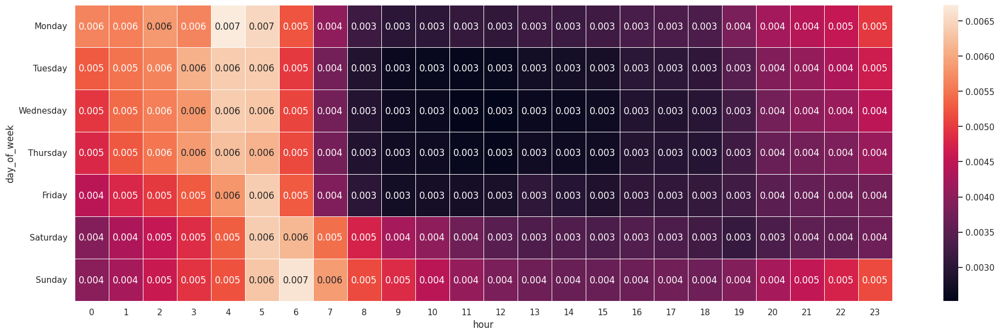

In [113]:
fig, ax = plt.subplots(figsize=(24, 7))
sns.heatmap(df_train_days_of_week_and_hours_to_speed_medians, annot=True, linewidth=.5, fmt=".1g", ax=ax)
plt.show()

Не забудьте удалить колонку со значением скорости из данных!

**Вопрос**: Почему значение скорости нельзя использовать во время обучения?

Удалим `avg_speed` из `X_train`:

In [114]:
X_train.drop(columns=["avg_speed"], inplace=True)

**Ответ на вопрос выше:** Значение средней скорости нельзя использовать во время обучения в нашем случае - с таргетом "Продолжительность поездки (время)", так как здесь скорость - учитывая, что считаем её как отношение кратчайшего пути к продолжительности поездки, то есть к таргету, - является не причиной, а следствием продолжительности поездки и многих других факторов (например, стояли ли мы в пробке или нет, была ли плохая погода, которая как-то мешала трафику и многие другие) => скорость здесь, как производный признак от таргета, не может позволить как-то лучше объяснить этот таргет. Тем более, если для трейна мы сможем посчитать скорость, для теста так не получится, так как у нас не будет продолжительности поездок - мы её должны в итоге предсказать.

**Вопрос**: Посмотрите внимательно на график и скажите, в какие моменты времени скорость минимальна; максимальна.

Создайте признаки "поездка совершается в период пробок" и "поездка совершается в период свободных дорог" (естественно, они не должен зависеть от скорости!):

**Ответ:** скорость минимальна (чёрная и тёмно-фиолетовая зона на heatmap'е выше, соотв. значению `0.003`):
- в пн, с 8 до 18 часов
- в вт, c 8 до 19 часов
- в ср, с 8 до 19 часов
- в чт, с 8 до 19 часов
- в пт, с 8 до 19 часов
- в сб, с 12 до 20 часов

Скорость максимальна (соотв. значению `0.007`):
- в пн, 5-6 часов
- в вс, 6 часов

**Создаём признак "поездка совершается в период пробок":**

Можно конечно для создания данного признака смотреть только на время, когда в среднем значения скоростей на heatmap'е наименьшие, и считать такие периоды времени периодами пробок, но я считаю, что это недостаточно сильный признак того, что в тот или иной момент на дорогах пробки. Учтём также и количество поездок, начавшихся в один и тот же период времени, так как можно предполагать, что не все поездки слишком длинные, => логично, что если одновременно совершается много поездок на такси, это увеличивает трафик на дорогах. Также, если у нас много поездок на такси одновременно, это может быть косвенным указанием на то, что сейчас время пробок/час пик.

Чтобы учесть оба фактора, создадим ещё один heatmap по периодам времени, где значения - кол-во поездок, начавшихся в тот или иной период времени. Изобразим затем два heatmap'а вместе и будем считать периодами пробок те периоды, когда поездок много и когда средняя скорость движения низкая (что значит - много, низко - опишем далее).

Вспомогательная таблица:

In [115]:
df_train_days_of_week_and_hours_to_trips = X_train.groupby(by=[X_train["pickup_datetime"].dt.day_name(), 'hour']).size().reset_index().rename(columns={"pickup_datetime": "day_of_week", 0: "trips"})

In [116]:
df_train_days_of_week_and_hours_to_trips

,day_of_week,hour,trips
0,Friday,0,6225
1,Friday,1,4076
2,Friday,2,2792
3,Friday,3,2045
4,Friday,4,1596
...,...,...,...
163,Wednesday,19,9572
164,Wednesday,20,9305
165,Wednesday,21,9438
166,Wednesday,22,8612


Отсортируем строки таблицы по дням недели:

In [117]:
days_of_week = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
df_train_days_of_week_and_hours_to_trips["day_of_week"] = pd.Categorical(df_train_days_of_week_and_hours_to_trips["day_of_week"], categories=days_of_week)
df_train_days_of_week_and_hours_to_trips.sort_values("day_of_week", inplace=True)

In [118]:
df_train_days_of_week_and_hours_to_trips

,day_of_week,hour,trips
47,Monday,23,4917
27,Monday,3,852
28,Monday,4,954
29,Monday,5,1468
30,Monday,6,3774
...,...,...,...
75,Sunday,3,4728
74,Sunday,2,6004
73,Sunday,1,7580
82,Sunday,10,6112


In [119]:
df_train_days_of_week_and_hours_to_trips = df_train_days_of_week_and_hours_to_trips.pivot(index="day_of_week", columns="hour", values="trips")
df_train_days_of_week_and_hours_to_trips

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
day_of_week,,,,,,,,,,,,,,,,,,,,,
Monday,3050,1772,1159,852,954,1468,3774,6088,7192,7027,...,6990,6903,6441,7613,9084,8515,7936,7822,6725,4917
Tuesday,3186,1789,1034,717,795,1481,4065,7021,8208,7646,...,7307,7130,6238,7790,9454,9177,8943,8915,8202,5981
Wednesday,3667,2174,1347,896,852,1425,4029,7166,8314,7711,...,7406,6964,6165,7587,9328,9572,9305,9438,8612,6801
Thursday,4468,2561,1498,1090,954,1600,4237,7312,8401,7541,...,7667,7190,6136,7511,9514,9837,9550,9896,9362,8087
Friday,6225,4076,2792,2045,1596,1709,3904,6743,8063,7420,...,7663,7211,6084,7698,9425,9969,9001,8812,9271,9197
Saturday,8362,6967,5856,4268,2641,1407,1796,2583,3818,5491,...,7591,7547,6945,7905,8978,9187,7752,7964,8687,9165
Sunday,8615,7580,6004,4728,3130,1376,1536,1933,3043,4451,...,7401,7132,6799,7554,7800,7062,6412,6119,5561,4438


А теперь - heatmap'ы - новый и старый:

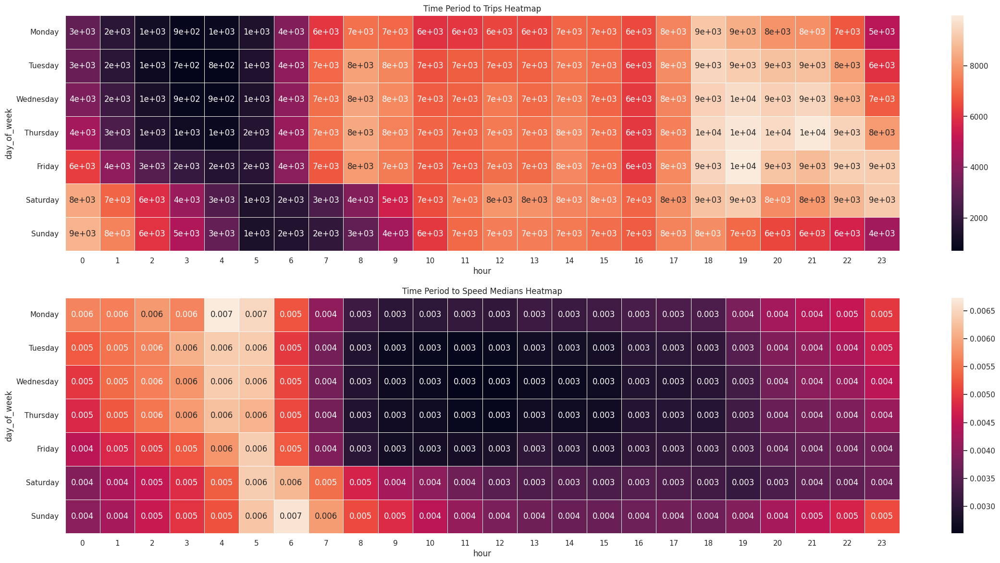

In [120]:
fig = plt.figure(figsize=(28, 14))
ax1 = fig.add_subplot(211)
sns.heatmap(df_train_days_of_week_and_hours_to_trips, annot=True, linewidth=.5, fmt=".1g", ax=ax1).set_title("Time Period to Trips Heatmap")

ax2 = fig.add_subplot(212)
sns.heatmap(df_train_days_of_week_and_hours_to_speed_medians, annot=True, linewidth=.5, fmt=".1g", ax=ax2).set_title("Time Period to Speed Medians Heatmap")
plt.show()

Пусть много поездок - 6000 и выше (красные и более светлые зоны на верхнем heatmap'е), скорость поездки низкая - если она равна 0.003 или ниже (фиолетовые и более тёмные зоны на нижнем heatmap'е).

Если период удовлетворяет условиям, что поездок много и что скорость поездки низкая, одновременно, то это - период пробок. Иначе - не период пробок. Отберем периоды пробок.

Пересоздадим вспомогательные таблицы, которые строили выше, так как pivot table в отличие от обычного датафрейма не сможем анализировать.

In [121]:
df_train_days_of_week_and_hours_to_trips = X_train.groupby(by=[X_train["pickup_datetime"].dt.day_name(), 'hour']).size().reset_index().rename(columns={"pickup_datetime": "day_of_week", 0: "trips"})
days_of_week = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
df_train_days_of_week_and_hours_to_trips["day_of_week"] = pd.Categorical(df_train_days_of_week_and_hours_to_trips["day_of_week"], categories=days_of_week)
df_train_days_of_week_and_hours_to_trips.sort_values("day_of_week", inplace=True)

In [122]:
X_train["avg_speed"] = X_train["haversine"] / X_train["trip_duration"]
df_train_days_of_week_and_hours_to_speed_medians = X_train.groupby(by=[X_train["pickup_datetime"].dt.day_name(), 'hour']).agg({'avg_speed': 'median'}).reset_index().rename(columns={"pickup_datetime": "day_of_week", "avg_speed": "speed_median"})
X_train.drop(columns=["avg_speed"], inplace=True)

days_of_week = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
df_train_days_of_week_and_hours_to_speed_medians["day_of_week"] = pd.Categorical(df_train_days_of_week_and_hours_to_speed_medians["day_of_week"], categories=days_of_week)
df_train_days_of_week_and_hours_to_speed_medians.sort_values("day_of_week", inplace=True)

Найдём периоды, когда средняя скорость поездок низкая:

In [123]:
df_train_time_periods_low_avg_speed = df_train_days_of_week_and_hours_to_speed_medians.loc[df_train_days_of_week_and_hours_to_speed_medians["speed_median"] <= 0.003, ["day_of_week", "hour"]]
df_train_time_periods_low_avg_speed["time_period"] = list(zip(df_train_time_periods_low_avg_speed["day_of_week"], df_train_time_periods_low_avg_speed["hour"]))
time_periods_low_avg_speed = set(df_train_time_periods_low_avg_speed["time_period"])

Найдём периоды, когда кол-во поездок высокое:

In [124]:
df_train_time_periods_high_trips_count =  df_train_days_of_week_and_hours_to_trips.loc[df_train_days_of_week_and_hours_to_trips["trips"] >= 6000, ["day_of_week", "hour"]]
df_train_time_periods_high_trips_count["time_period"] = list(zip(df_train_time_periods_high_trips_count["day_of_week"], df_train_time_periods_high_trips_count["hour"]))
time_periods_high_trips_count = set(df_train_time_periods_high_trips_count["time_period"])

Пересечём полученные нами множества:

In [125]:
time_periods_with_very_high_traffic = list(time_periods_low_avg_speed & time_periods_high_trips_count)

Наконец, создадим новые признаки для `X_train` и для `X_test`: сейчас пробка, если `pickup_datetime` соответствует времени в `time_periods_with_very_high_traffic`, иначе - не пробка.

In [126]:
X_train["time_period"] = list(zip(X_train["pickup_datetime"].dt.day_name(), X_train["hour"]))
X_train["is_traffic_very_high"] = X_train["time_period"].isin(time_periods_with_very_high_traffic)
X_train.drop(columns=["time_period"], inplace=True)

In [127]:
X_test["time_period"] = list(zip(X_test["pickup_datetime"].dt.day_name(), X_test["hour"]))
X_test["is_traffic_very_high"] = X_test["time_period"].isin(time_periods_with_very_high_traffic)
X_test.drop(columns=["time_period"], inplace=True)

**Создаём признак "поездка совершается в период свободных дорог":**

Здесь логика - наоборот тому, что делали для пробок: дороги свободны, если поездок очень мало, а средняя скорость поездки высокая. Считаем, что поездок в некоторый период очень мало, если их не более 2000 (тёмные зоны на верхнем heatmap'е выше), средняя скорость поездки высокая, если она равна 0.006 или выше (оранжевые и более светлые зоны на нижнем heatmap'е выше).

Найдём периоды, когда средняя скорость поездок высокая:

In [128]:
df_train_time_periods_high_avg_speed = df_train_days_of_week_and_hours_to_speed_medians.loc[df_train_days_of_week_and_hours_to_speed_medians["speed_median"] >= 0.006, ["day_of_week", "hour"]]
df_train_time_periods_high_avg_speed["time_period"] = list(zip(df_train_time_periods_high_avg_speed["day_of_week"], df_train_time_periods_high_avg_speed["hour"]))
time_periods_high_avg_speed = set(df_train_time_periods_high_avg_speed["time_period"])

Найдём периоды, когда кол-во поездок очень низкое:

In [129]:
df_train_time_periods_low_trips_count =  df_train_days_of_week_and_hours_to_trips.loc[df_train_days_of_week_and_hours_to_trips["trips"] <= 2000, ["day_of_week", "hour"]]
df_train_time_periods_low_trips_count["time_period"] = list(zip(df_train_time_periods_low_trips_count["day_of_week"], df_train_time_periods_low_trips_count["hour"]))
time_periods_low_trips_count = set(df_train_time_periods_low_trips_count["time_period"])

Пересечём полученные нами множества:

In [130]:
time_periods_with_very_low_traffic = list(time_periods_high_avg_speed & time_periods_low_trips_count)

Наконец, создадим новые признаки для `X_train` и для `X_test`: сейчас дороги свободны, если `pickup_datetime` соответствует времени в `time_periods_with_very_low_traffic`, иначе - не считаем, что дороги свободны.

In [131]:
X_train["time_period"] = list(zip(X_train["pickup_datetime"].dt.day_name(), X_train["hour"]))
X_train["is_traffic_very_low"] = X_train["time_period"].isin(time_periods_with_very_low_traffic)
X_train.drop(columns=["time_period"], inplace=True)

In [132]:
X_test["time_period"] = list(zip(X_test["pickup_datetime"].dt.day_name(), X_test["hour"]))
X_test["is_traffic_very_low"] = X_test["time_period"].isin(time_periods_with_very_low_traffic)
X_test.drop(columns=["time_period"], inplace=True)

In [133]:
X_train.head()

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,log_trip_duration,store_and_fwd_flag,id,...,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,haversine,log_haversine,trip_duration,is_traffic_very_high,is_traffic_very_low
0,5,9,1,1,False,False,124,6.739337,N,id2209155,...,2,-73.979813,40.752529,-73.982681,40.763680,1.263187,0.816774,844.0,True,False
1,1,16,4,4,False,False,1,6.909753,N,id0586605,...,1,-73.977623,40.746296,-73.968414,40.788933,4.804012,1.758549,1001.0,False,False
2,4,13,6,6,False,False,115,6.955593,N,id0467144,...,1,-73.950699,40.779404,-73.863129,40.768608,7.471088,2.136659,1048.0,False,False
3,1,17,6,6,False,False,10,6.665684,N,id0989010,...,1,-73.984558,40.721802,-73.976753,40.752213,3.444869,1.491750,784.0,False,False
4,2,17,3,3,False,False,56,6.597146,N,id0580742,...,1,-73.967720,40.768742,-73.977173,40.789875,2.481063,1.247338,732.0,True,False


In [134]:
X_test.head()

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,log_trip_duration,store_and_fwd_flag,id,...,pickup_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,haversine,log_haversine,is_traffic_very_high,is_traffic_very_low
0,6,7,2,2,False,False,160,6.947937,N,id2793718,...,2016-06-08 07:36:19,1,-73.985611,40.735943,-73.980331,40.760468,2.763050,1.325230,False,False
1,4,12,6,6,False,False,94,6.719013,N,id3485529,...,2016-04-03 12:58:11,1,-73.978394,40.764351,-73.991623,40.749859,1.959178,1.084912,False,False
2,6,2,6,6,False,False,157,6.421622,N,id1816614,...,2016-06-05 02:49:13,5,-73.989059,40.744389,-73.973381,40.748692,1.404772,0.877455,False,False
3,5,17,3,3,False,False,126,6.766192,N,id1050851,...,2016-05-05 17:18:27,2,-73.990326,40.731136,-73.991264,40.748917,1.978660,1.091473,True,False
4,5,17,3,3,False,False,133,8.510773,N,id0140657,...,2016-05-12 17:43:38,4,-73.789497,40.646675,-73.987137,40.759232,20.837745,3.083640,True,False


**Задание 8 (0.25 балла)**. Для каждого из замеченных вами выше 2-3 пунктов добавьте в выборку по два признака:
- началась ли поездка в этом пункте
- закончилась ли поездка в этом пункте

Как вы думаете, почему эти признаки могут быть полезны?

**Идея:** особые точки на карте - два аэропорта - JFK Airport и LaGuardia Airport. На реальной карте они отмечены просто точками, но кластеры поездок к ним или от них заканчиваются/начинаются в целой зоне, а не в одной точке. Поэтому ограничим по реальной карте некоторые приближенные к реальности границы аэропортов прямоугольниками (ограничения - в значениях широты и долготы, верхняя точка аэропорта соответствует верхней горизонтальной стороне прямоугольника, нижняя - нижней и т.д.), которые и будем считать за границы аэропортов. Далее - для создания признака - будем проверять, лежит ли pickup-точка/dropoff-точка в данном прямоугольнике. Если да, то соответствующий признак равен True, иначе - False.

**JFK Airport:**

На нашей карте:

<img src="https://drive.google.com/uc?export=view&id=1-eXTkyvx9F2YuRcG6UDHrq3p0w7lYRi9" width="50%">

<img src="https://drive.google.com/uc?export=view&id=16O05kB7vAGQQK9I1P2Utd1oGW_b7rZVK" width="50%">

В Google Maps:

<img src="https://drive.google.com/uc?export=view&id=1O5ZJlsKhmvB6F4msWY40E6Iwjc92NoQX" width="50%">

Выберем теперь границы прямоугольника по крайним точкам области аэропорта:

Долгота (самая левая и самая правая точки):

<img src="https://drive.google.com/uc?export=view&id=1TeYrNyW9KNY-3sNZH-gab6Xxvi3MG9Cl" width="50%">

<img src="https://drive.google.com/uc?export=view&id=19YQNDpFHX0mPHMFtfceI6sjf-GJdXVrr" width="50%">

Широта (самая верхняя и нижняя точки):

<img src="https://drive.google.com/uc?export=view&id=1zadb-IP0WQ4SceRlPyOa9APjwuR4dTWS" width="50%">

<img src="https://drive.google.com/uc?export=view&id=1bafzhvbvMUgmeg99xrUqiwgpg6hNBbaz" width="50%">

Отсюда искомые границы (координаты сторон прямоугольника):

In [135]:
JFK_airport_latitude = [40.621990, 40.664713]
JFK_airport_longitude = [-73.823837, -73.747962]

Создадим необходимые нам признаки:

`X_train`:

In [136]:
X_train["was_pickup_in_JFK_airport"] = ((X_train["pickup_longitude"] >= JFK_airport_longitude[0]) & (X_train["pickup_longitude"] <= JFK_airport_longitude[1]) &
                                        (X_train["pickup_latitude"] >= JFK_airport_latitude[0]) & (X_train["pickup_latitude"] <= JFK_airport_latitude[1]))

X_train["was_dropoff_in_JFK_airport"] = ((X_train["dropoff_longitude"] >= JFK_airport_longitude[0]) & (X_train["dropoff_longitude"] <= JFK_airport_longitude[1]) &
                                         (X_train["dropoff_latitude"] >= JFK_airport_latitude[0]) & (X_train["dropoff_latitude"] <= JFK_airport_latitude[1]))

`X_test`:

In [137]:
X_test["was_pickup_in_JFK_airport"] = ((X_test["pickup_longitude"] >= JFK_airport_longitude[0]) & (X_test["pickup_longitude"] <= JFK_airport_longitude[1]) &
                                        (X_test["pickup_latitude"] >= JFK_airport_latitude[0]) & (X_test["pickup_latitude"] <= JFK_airport_latitude[1]))

X_test["was_dropoff_in_JFK_airport"] = ((X_test["dropoff_longitude"] >= JFK_airport_longitude[0]) & (X_test["dropoff_longitude"] <= JFK_airport_longitude[1]) &
                                         (X_test["dropoff_latitude"] >= JFK_airport_latitude[0]) & (X_test["dropoff_latitude"] <= JFK_airport_latitude[1]))

**LaGuardia Airport:**

На нашей карте:

<img src="https://drive.google.com/uc?export=view&id=1R-s3RnVQ1ELQTts7S-APrADBli58GAD6" width="50%">

<img src="https://drive.google.com/uc?export=view&id=1YZZsgLNxeqoI0zMxVkrburL-zahP2MqG" width="50%">

В Google Maps:

<img src="https://drive.google.com/uc?export=view&id=1D2cXA-5ONxNMTXp0oVXqdUcVAUtBb_gD" width="50%">

Долгота (самая левая и самая правая точки):

<img src="https://drive.google.com/uc?export=view&id=1UK1TsG9RhB9ULdtN4vrsuH5_gDwioIQu" width="50%">

<img src="https://drive.google.com/uc?export=view&id=1oMwxExzhixAVjXbcPlEvdevDbFc8_sFJ" width="50%">

Широта (самая верхняя и нижняя точки):

<img src="https://drive.google.com/uc?export=view&id=1V2X2DcUUOF7jLlEAehh4Enp4KDGbMHtv" width="50%">

<img src="https://drive.google.com/uc?export=view&id=1mdeLORAZ5nqqjiWk0x21Ws0h738YE9pW" width="50%">

Отсюда искомые границы (координаты сторон прямоугольника):

In [138]:
LaGuardia_airport_latitude = [40.767501, 40.785959]
LaGuardia_airport_longitude = [-73.890446, -73.855169]

Создадим необходимые нам признаки:

`X_train`:

In [139]:
X_train["was_pickup_in_LaGuardia_airport"] = ((X_train["pickup_longitude"] >= LaGuardia_airport_longitude[0]) & (X_train["pickup_longitude"] <= LaGuardia_airport_longitude[1]) &
                                        (X_train["pickup_latitude"] >= LaGuardia_airport_latitude[0]) & (X_train["pickup_latitude"] <= LaGuardia_airport_latitude[1]))

X_train["was_dropoff_in_LaGuardia_airport"] = ((X_train["dropoff_longitude"] >= LaGuardia_airport_longitude[0]) & (X_train["dropoff_longitude"] <= LaGuardia_airport_longitude[1]) &
                                         (X_train["dropoff_latitude"] >= LaGuardia_airport_latitude[0]) & (X_train["dropoff_latitude"] <= LaGuardia_airport_latitude[1]))

`X_test`:

In [140]:
X_test["was_pickup_in_LaGuardia_airport"] = ((X_test["pickup_longitude"] >= LaGuardia_airport_longitude[0]) & (X_test["pickup_longitude"] <= LaGuardia_airport_longitude[1]) &
                                        (X_test["pickup_latitude"] >= LaGuardia_airport_latitude[0]) & (X_test["pickup_latitude"] <= LaGuardia_airport_latitude[1]))

X_test["was_dropoff_in_LaGuardia_airport"] = ((X_test["dropoff_longitude"] >= LaGuardia_airport_longitude[0]) & (X_test["dropoff_longitude"] <= LaGuardia_airport_longitude[1]) &
                                         (X_test["dropoff_latitude"] >= LaGuardia_airport_latitude[0]) & (X_test["dropoff_latitude"] <= LaGuardia_airport_latitude[1]))

**Ответ на вопрос, почему эти признаки могут быть полезны:** Аэропорты создают аномально высокий трафик такси со специфическим по длительности маршрутом: поездки по городу скорее будут короче по расстоянию, чем от аэропорта, который находится на удалении от центра города, в город (и наоборот, от города в аэропорт). Отсюда новые признаки являются достаточно сильными факторами для достаточно относительно количества поездок (конечно, в масштабах нашей выборки (train'а) это не достаточно немного, но тем не менее).

В подтверждение этой идеи посмотрим на кол-во поездок, начинающихся в этих аэропортах и заканчивающихся в этих аэропортах (по отдельности), также посмотрим на их долю от кол-ва элементов выборки.

`X_train`:

In [141]:
pickups_in_airports_num_train = len(X_train[X_train["was_pickup_in_JFK_airport"]]) + len(X_train[X_train["was_pickup_in_LaGuardia_airport"]])
print("Кол-во поездок, начинающихся в аэропортах:", pickups_in_airports_num_train)
print("Доля кол-ва поездок, начинающихся в аэропортах, от кол-ва всех поездок:", pickups_in_airports_num_train / len(X_train))
print()
dropoffs_in_airports_num_train = len(X_train[X_train["was_dropoff_in_JFK_airport"]]) + len(X_train[X_train["was_dropoff_in_LaGuardia_airport"]])
print("Кол-во поездок, заканчивающихся в аэропортах:", dropoffs_in_airports_num_train)
print("Доля кол-ва поездок, заканчивающихся в аэропортах, от кол-ва всех поездок:", dropoffs_in_airports_num_train / len(X_train))

Кол-во поездок, начинающихся в аэропортах: 48284
Доля кол-ва поездок, начинающихся в аэропортах, от кол-ва всех поездок: 0.047288575486019294

Кол-во поездок, заканчивающихся в аэропортах: 21464
Доля кол-ва поездок, заканчивающихся в аэропортах, от кол-ва всех поездок: 0.021021497478086282


`X_test`:

In [142]:
pickups_in_airports_num_test = len(X_test[X_test["was_pickup_in_JFK_airport"]]) + len(X_test[X_test["was_pickup_in_LaGuardia_airport"]])
print("Кол-во поездок, начинающихся в аэропортах:", pickups_in_airports_num_test)
print("Доля кол-ва поездок, начинающихся в аэропортах, от кол-ва всех поездок:", pickups_in_airports_num_test / len(X_test))
print()
dropoffs_in_airports_num_test = len(X_test[X_test["was_dropoff_in_JFK_airport"]]) + len(X_test[X_test["was_dropoff_in_LaGuardia_airport"]])
print("Кол-во поездок, заканчивающихся в аэропортах:", dropoffs_in_airports_num_test)
print("Доля кол-ва поездок, заканчивающихся в аэропортах, от кол-ва всех поездок:", dropoffs_in_airports_num_test / len(X_test))

Кол-во поездок, начинающихся в аэропортах: 20693
Доля кол-ва поездок, начинающихся в аэропортах, от кол-ва всех поездок: 0.04728812552274483

Кол-во поездок, заканчивающихся в аэропортах: 9193
Доля кол-ва поездок, заканчивающихся в аэропортах, от кол-ва всех поездок: 0.021008057697317607


Для каждого из созданных признаков нарисуйте "ящик с усами" (`sns.boxplot`) распределения логарифма времени поездки

**Train:**

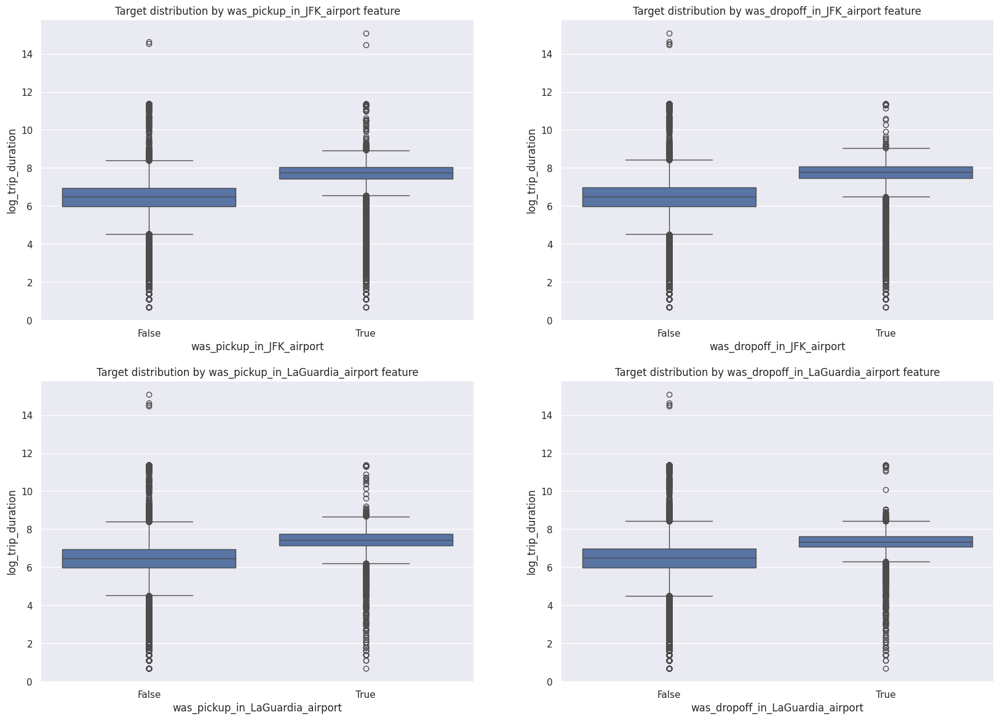

In [143]:
fig = plt.figure(figsize=(20, 14))
ax1 = fig.add_subplot(221)
sns.boxplot(x=X_train["was_pickup_in_JFK_airport"], y=y_train, ax=ax1).set_title("Target distribution by was_pickup_in_JFK_airport feature")

ax2 = fig.add_subplot(222)
sns.boxplot(x=X_train["was_dropoff_in_JFK_airport"], y=y_train, ax=ax2).set_title("Target distribution by was_dropoff_in_JFK_airport feature")

ax3 = fig.add_subplot(223)
sns.boxplot(x=X_train["was_pickup_in_LaGuardia_airport"], y=y_train, ax=ax3).set_title("Target distribution by was_pickup_in_LaGuardia_airport feature")

ax4 = fig.add_subplot(224)
sns.boxplot(x=X_train["was_dropoff_in_LaGuardia_airport"], y=y_train, ax=ax4).set_title("Target distribution by was_dropoff_in_LaGuardia_airport feature")

plt.show()

**Test:**

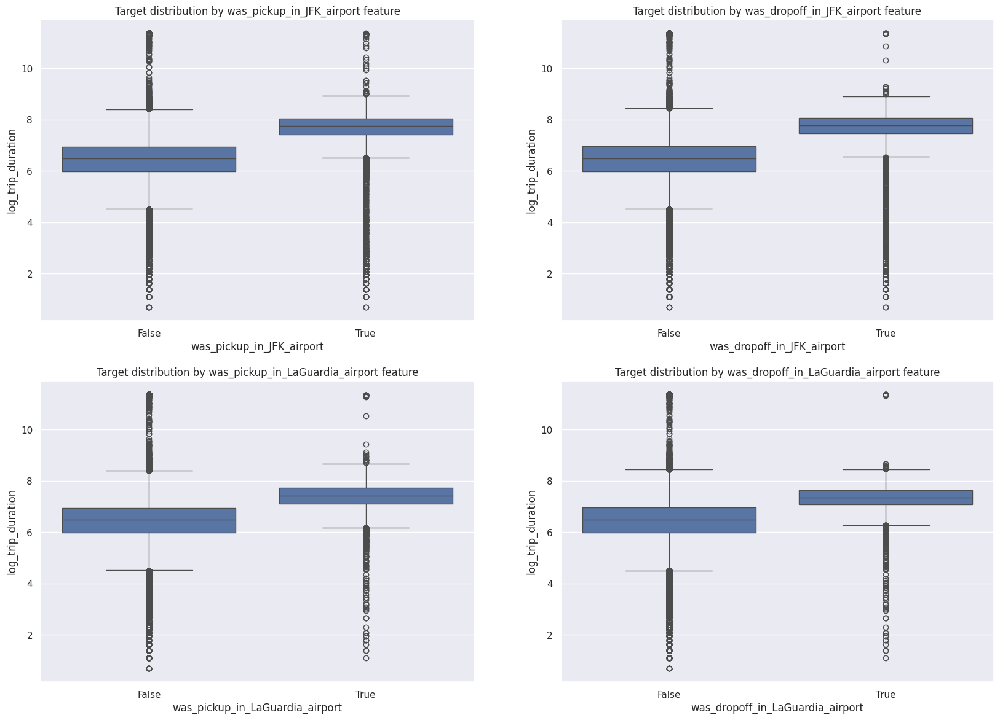

In [144]:
fig = plt.figure(figsize=(20, 14))
ax1 = fig.add_subplot(221)
sns.boxplot(x=X_test["was_pickup_in_JFK_airport"], y=y_test, ax=ax1).set_title("Target distribution by was_pickup_in_JFK_airport feature")

ax2 = fig.add_subplot(222)
sns.boxplot(x=X_test["was_dropoff_in_JFK_airport"], y=y_test, ax=ax2).set_title("Target distribution by was_dropoff_in_JFK_airport feature")

ax3 = fig.add_subplot(223)
sns.boxplot(x=X_test["was_pickup_in_LaGuardia_airport"], y=y_test, ax=ax3).set_title("Target distribution by was_pickup_in_LaGuardia_airport feature")

ax4 = fig.add_subplot(224)
sns.boxplot(x=X_test["was_dropoff_in_LaGuardia_airport"], y=y_test, ax=ax4).set_title("Target distribution by was_dropoff_in_LaGuardia_airport feature")

plt.show()

**Вопрос**: судя по графикам, как вы думаете, хорошими ли получились эти признаки?

**Ответ:** видим из боксплотов, что если отсортируем все элементы выборки (элемент выборки - объект и значение таргета для него) по возрастанию по значению таргета и посмотрим на распределения в зависимости от значения одного из четырёх новых признаков, то получим разные распределения для разных значений нового признака для каждого из них, причём ситуация похожа и для трейна, и для теста, и для каждого из этих признаков:
- **медиана лог-продолжительности поездки** в случае поездки от одного/к одному из двух рассматриваемых нами аэропортов **больше**, чем в случае обычной поездки (не связанной с этими аэропортами);

- **разброс боксплота (Interquartile Range (IQR) и усы)** также будет **меньше** в случае поездки от одного/к одному из двух рассматриваемых нами аэропортов, чем в случае обычной поездки;

- при всём при этом для выбросов для боксплота (значения выше верхнего уса и значения ниже нижнего уса) никаких таких закономерностей нет.


Таким образом, для каждого из новых признаков верно: распределения таргета разные, если значения признака разные => признак даёт нам новую информацию об объектах => повлияет на качество наших предсказаний - лучше станем определять поездки из данных аэропортов/в данные аэропорты. Поэтому **новые признаки действительно хорошие**. **С другой стороны, в силу того, что доли кол-ва поездок, начавшихся/закончившихся в каком-то из данных аэропортов, к кол-ву всех поездок достаточно малы, модель с добавлением этих признаков улучшится незначительно.**

<img src="https://www.dropbox.com/s/xson9nukz5hba7c/map.png?raw=1" align="right" width="20%" style="margin-left: 20px; margin-bottom: 20px">

**Задание 9 (1 балл)**. Сейчас мы почти что не используем сами значения координат. На это есть несколько причин: по отдельности рассматривать широту и долготу не имеет особого смысла, стоит рассматривать их вместе. Во-вторых, понятно, что зависимость между нашим таргетом и координатами не линейная. Чтобы как-то использовать координаты, можно прибегнуть к следующему трюку: обрамим область с наибольшим количеством поездок прямоугольником (как на рисунке). Разобьем этот прямоугольник на ячейки. Каждой точке сопоставим номер ее ячейки, а тем точкам, что не попали ни в одну из ячеек, сопоставим значение -1.

Напишите трансформер, который сначала разбивает показанную на рисунке область на ячейки, а затем создает два признака: номер ячейки, в которой началась поездка, и номер ячейки, в которой закончилась поездка. Количество строк и столбцов выберите самостоятельно.

Обратите внимание, что все вычисления должны быть векторизованными, трансформер не должен модифицировать передаваемую ему выборку inplace, а все необходимые статистики (если они вдруг нужны) нужно считать только по обучающей выборке в методе `fit`:

**Решение:**

Посмотрим на большее кол-во точек на карте:

In [145]:
show_circles_on_map(df.sample(10000), "pickup_latitude", "pickup_longitude", "blue")

In [146]:
show_circles_on_map(df.sample(10000), "dropoff_latitude", "dropoff_longitude", "blue")

На карте видно, что независимо от выбора сэмпла от исходной выборки (`df.sample`), наибольшее кол-во поездок совершается в районе Манхэттена. Значит, надо ограничить каким-то образом весь Манхэттен прямоугольником (по которому затем будем делать разбиение с помощью сетки). Воспользуемся той же идеей, что и для поиска координат для сторон прямоугольников, ограничивающих аэропорты: найдём самую верхнюю, самую нижнюю, левейшую и правейшую точку Манхэттена на карте (например, с помощью Google Maps), они будут задавать искомые границы (соответствующие сторонам прямоугольника). Границы прямоугольника будем передавать в `__init__` класса-трансформера.  

Ниже будут только ссылки, иначе предпросмтор на гитхабе не грузит(

Манхэттен на нашей карте:

"https://drive.google.com/uc?export=view&id=1lGJsxySfWHMWLKUqxvMlMcnC8NDmvRgL"

"https://drive.google.com/uc?export=view&id=1n6acPD9IyEaiWj3oK0Duj0ugiQyJwnxj"

Манхэттен в Google Maps:

"https://drive.google.com/uc?export=view&id=1MsXELa6P93ygdZD2Dw19XaIPvgVQaQ6U"

Долгота (самая левая и самая правая точки):

"https://drive.google.com/uc?export=view&id=1H5uLIFm_gbiyRy2FWvdtlWbMAbYsXWVz"

"https://drive.google.com/uc?export=view&id=1KBSaw1VzqDkkSOOyhdsXaOHf1cconPvz"

Широта (самая верхняя и самая нижняя точки):

"https://drive.google.com/uc?export=view&id=1OEK6eCCbzmpQgGfmxOmAyyWhPrnSktWb"

"https://drive.google.com/uc?export=view&id=1spFIi3KleUeknRk0hQNy_BQCuExd5Orh"

Отсюда имеем следующие границы:

In [147]:
manhattan_latitude = [40.700643, 40.877465]
manhattan_longitude = [-74.019397, -73.928561]

Теперь пишем трансформер (нумерация зон-клеток сетки идёт с нуля, след образом:

$\begin{bmatrix}
6 & 7 & 8 \\
3 & 4 & 5 \\
0 & 1 & 2
\end{bmatrix}$
):

In [148]:
from sklearn.base import BaseEstimator, TransformerMixin


# TransformerMixin implements fit_transform for you,
# applying your fit and transform consistently

class MapGridTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, area_latitude, area_longitude, rows, cols):
        self.area_lat = area_latitude
        self.area_lng = area_longitude
        self.rows = rows
        self.cols = cols


    def show_map(self, data, latitude_column, longitude_column, circle_color='blue', grid_color='orange'):
        location = (data[latitude_column].mean(), data[longitude_column].mean())
        m = folium.Map(location=location)

        for _, row in data.iterrows():
            folium.Circle(
                radius=100,
                location=(row[latitude_column], row[longitude_column]),
                color=circle_color,
                fill_color=circle_color,
                fill=True
            ).add_to(m)

        for row in range(self.rows):
            for col in range(self.cols):
                folium.Rectangle(
                    bounds=[[self.area_lat[0] + (self.area_lat[1] - self.area_lat[0]) / self.rows * row,
                             self.area_lng[0] + (self.area_lng[1] - self.area_lng[0]) / self.cols * col],
                            [self.area_lat[0] + (self.area_lat[1] - self.area_lat[0]) / self.rows * (row + 1),
                             self.area_lng[0] + (self.area_lng[1] - self.area_lng[0]) / self.cols * (col + 1)]
                            ],
                    line_join="round",
                    color=grid_color,
                    fill=True,
                    fill_color=grid_color,
                    popup="row {0}, col {1} => cell number is {2}".format(str(row), str(col), str(row * self.cols + col)),
                    tooltip="<strong>Click me!</strong>"
                ).add_to(m)

        return m


    def fit(self, X=None, y=None):
        return self


    def transform(self, X, y=None):
        X_mod = X.copy(deep=True)

        # Длины сторон одной ячейки (в градусах)
        cell_height = (self.area_lat[1] - self.area_lat[0]) / self.rows
        cell_width = (self.area_lng[1] - self.area_lng[0]) / self.cols

        # pickup
        X_mod["manhattan_zone_pickup"] = -1
        X_mod["manhattan_zone_pickup_row"] = -1
        X_mod["manhattan_zone_pickup_col"] = -1

        cond_pickup_in_manhattan = ((X_mod["pickup_latitude"] >= self.area_lat[0]) & (X_mod["pickup_latitude"] <= self.area_lat[1]) &
                                    (X_mod["pickup_longitude"] >= self.area_lng[0]) & (X_mod["pickup_longitude"] <= self.area_lng[1]))

        X_mod.loc[cond_pickup_in_manhattan, "manhattan_zone_pickup_row"] = ((X_mod.loc[cond_pickup_in_manhattan, "pickup_latitude"] - self.area_lat[0]) / cell_height).astype(int)
        X_mod.loc[cond_pickup_in_manhattan, "manhattan_zone_pickup_col"] = ((X_mod.loc[cond_pickup_in_manhattan, "pickup_longitude"] - self.area_lng[0]) / cell_width).astype(int)
        X_mod.loc[cond_pickup_in_manhattan, "manhattan_zone_pickup"] = X_mod.loc[cond_pickup_in_manhattan, "manhattan_zone_pickup_row"] * self.cols + X_mod.loc[cond_pickup_in_manhattan, "manhattan_zone_pickup_col"]

        X_mod.drop(columns=["manhattan_zone_pickup_row", "manhattan_zone_pickup_col"], inplace=True)

        # dropoff
        X_mod["manhattan_zone_dropoff"] = -1
        X_mod["manhattan_zone_dropoff_row"] = -1
        X_mod["manhattan_zone_dropoff_col"] = -1

        cond_dropoff_in_manhattan = ((X_mod["dropoff_latitude"] >= self.area_lat[0]) & (X_mod["dropoff_latitude"] <= self.area_lat[1]) &
                                    (X_mod["dropoff_longitude"] >= self.area_lng[0]) & (X_mod["dropoff_longitude"] <= self.area_lng[1]))

        X_mod.loc[cond_dropoff_in_manhattan, "manhattan_zone_dropoff_row"] = ((X_mod.loc[cond_dropoff_in_manhattan, "dropoff_latitude"] - self.area_lat[0]) / cell_height).astype(int)
        X_mod.loc[cond_dropoff_in_manhattan, "manhattan_zone_dropoff_col"] = ((X_mod.loc[cond_dropoff_in_manhattan, "dropoff_longitude"] - self.area_lng[0]) / cell_width).astype(int)
        X_mod.loc[cond_dropoff_in_manhattan, "manhattan_zone_dropoff"] = X_mod.loc[cond_dropoff_in_manhattan, "manhattan_zone_dropoff_row"] * self.cols + X_mod.loc[cond_dropoff_in_manhattan, "manhattan_zone_dropoff_col"]

        X_mod.drop(columns=["manhattan_zone_dropoff_row", "manhattan_zone_dropoff_col"], inplace=True)

        return X_mod

In [155]:
manhattan_grid_transformer = MapGridTransformer(manhattan_latitude, manhattan_longitude, 5, 3)

**Немного визуализации (ячейки кликабельны!!!):**

In [156]:
manhattan_grid_transformer.show_map(df.sample(10000), "pickup_latitude", "pickup_longitude")

In [151]:
manhattan_grid_transformer.show_map(df.sample(10000), "dropoff_latitude", "dropoff_longitude")

Проверим, что всё работает, ничего не падает:

In [157]:
manhattan_grid_transformer.fit_transform(X_train)

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,log_trip_duration,store_and_fwd_flag,id,...,log_haversine,trip_duration,is_traffic_very_high,is_traffic_very_low,was_pickup_in_JFK_airport,was_dropoff_in_JFK_airport,was_pickup_in_LaGuardia_airport,was_dropoff_in_LaGuardia_airport,manhattan_zone_pickup,manhattan_zone_dropoff
0,5,9,1,1,False,False,124,6.739337,N,id2209155,...,0.816774,844.0,True,False,False,False,False,False,4,4
1,1,16,4,4,False,False,1,6.909753,N,id0586605,...,1.758549,1001.0,False,False,False,False,False,False,4,7
2,4,13,6,6,False,False,115,6.955593,N,id0467144,...,2.136659,1048.0,False,False,False,False,False,True,8,-1
3,1,17,6,6,False,False,10,6.665684,N,id0989010,...,1.491750,784.0,False,False,False,False,False,False,1,4
4,2,17,3,3,False,False,56,6.597146,N,id0580742,...,1.247338,732.0,True,False,False,False,False,False,4,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1021045,3,7,4,4,False,False,85,7.156177,N,id1753868,...,1.842196,1281.0,False,False,False,False,False,False,8,3
1021046,2,18,1,1,False,False,47,6.726233,N,id2204747,...,1.023809,833.0,False,False,False,False,False,False,4,4
1021047,1,19,1,1,False,False,26,7.159292,N,id3043606,...,2.129142,1285.0,False,False,False,False,False,False,0,8
1021048,1,11,1,1,False,False,19,5.966147,N,id1458584,...,0.496046,389.0,True,False,False,False,False,False,4,4


Сработало!

Проверим, что изменения - не inplace:

In [158]:
X_train

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,log_trip_duration,store_and_fwd_flag,id,...,dropoff_latitude,haversine,log_haversine,trip_duration,is_traffic_very_high,is_traffic_very_low,was_pickup_in_JFK_airport,was_dropoff_in_JFK_airport,was_pickup_in_LaGuardia_airport,was_dropoff_in_LaGuardia_airport
0,5,9,1,1,False,False,124,6.739337,N,id2209155,...,40.763680,1.263187,0.816774,844.0,True,False,False,False,False,False
1,1,16,4,4,False,False,1,6.909753,N,id0586605,...,40.788933,4.804012,1.758549,1001.0,False,False,False,False,False,False
2,4,13,6,6,False,False,115,6.955593,N,id0467144,...,40.768608,7.471088,2.136659,1048.0,False,False,False,False,False,True
3,1,17,6,6,False,False,10,6.665684,N,id0989010,...,40.752213,3.444869,1.491750,784.0,False,False,False,False,False,False
4,2,17,3,3,False,False,56,6.597146,N,id0580742,...,40.789875,2.481063,1.247338,732.0,True,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1021045,3,7,4,4,False,False,85,7.156177,N,id1753868,...,40.749424,5.310383,1.842196,1281.0,False,False,False,False,False,False
1021046,2,18,1,1,False,False,47,6.726233,N,id2204747,...,40.749874,1.783777,1.023809,833.0,False,False,False,False,False,False
1021047,1,19,1,1,False,False,26,7.159292,N,id3043606,...,40.785282,7.407646,2.129142,1285.0,False,False,False,False,False,False
1021048,1,11,1,1,False,False,19,5.966147,N,id1458584,...,40.768669,0.642215,0.496046,389.0,True,False,False,False,False,False


Действительно, `X_train` не изменилась.

**Задание 10 (0.25 балла)**. Обучите `Ridge`-регрессию со стандартными параметрами на признаках, которые мы выделили к текущему моменту. Категориальные признаки закодируйте через one-hot-кодирование, числовые признаки отмасштабируйте.

Применим новый трансформер из прошлого задания (сейчас, так как потом в силу того, что зона Манхэттена - категориальный признак, будем применять к нему OneHot-Encoding).

In [159]:
manhattan_grid_transformer = MapGridTransformer(manhattan_latitude, manhattan_longitude, 5, 3)

In [160]:
X_train = manhattan_grid_transformer.fit_transform(X_train)

Оставим в `X_train` только колонки с новыми признаками, связанными со временем и положением начала/конца поездки (признаки, которые создавали в 1 и 2 частях).

In [161]:
X_train.columns

Index(['month', 'hour', 'weekday', 'day_of_week', 'is_anomaly_1',
       'is_anomaly_2', 'day', 'log_trip_duration', 'store_and_fwd_flag', 'id',
       'vendor_id', 'pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'haversine',
       'log_haversine', 'trip_duration', 'is_traffic_very_high',
       'is_traffic_very_low', 'was_pickup_in_JFK_airport',
       'was_dropoff_in_JFK_airport', 'was_pickup_in_LaGuardia_airport',
       'was_dropoff_in_LaGuardia_airport', 'manhattan_zone_pickup',
       'manhattan_zone_dropoff'],
      dtype='object')

In [162]:
columns_to_drop = ['log_trip_duration', 'store_and_fwd_flag', 'id', 'vendor_id',
                   'pickup_datetime', 'passenger_count', 'pickup_longitude',
                   'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'trip_duration']

X_train_dropped = X_train[columns_to_drop] # сохраняем те колонки, что собираемся дропать, для будущих заданий

X_train.drop(columns=columns_to_drop, inplace=True)

In [163]:
X_train.head()

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,haversine,log_haversine,is_traffic_very_high,is_traffic_very_low,was_pickup_in_JFK_airport,was_dropoff_in_JFK_airport,was_pickup_in_LaGuardia_airport,was_dropoff_in_LaGuardia_airport,manhattan_zone_pickup,manhattan_zone_dropoff
0,5,9,1,1,False,False,124,1.263187,0.816774,True,False,False,False,False,False,4,4
1,1,16,4,4,False,False,1,4.804012,1.758549,False,False,False,False,False,False,4,7
2,4,13,6,6,False,False,115,7.471088,2.136659,False,False,False,False,False,True,8,-1
3,1,17,6,6,False,False,10,3.444869,1.491750,False,False,False,False,False,False,1,4
4,2,17,3,3,False,False,56,2.481063,1.247338,True,False,False,False,False,False,4,7


То же самое сделаем с `X_test`:

In [164]:
X_test = manhattan_grid_transformer.fit_transform(X_test)

In [165]:
X_test.columns

Index(['month', 'hour', 'weekday', 'day_of_week', 'is_anomaly_1',
       'is_anomaly_2', 'day', 'log_trip_duration', 'store_and_fwd_flag', 'id',
       'vendor_id', 'pickup_datetime', 'passenger_count', 'pickup_longitude',
       'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'haversine',
       'log_haversine', 'is_traffic_very_high', 'is_traffic_very_low',
       'was_pickup_in_JFK_airport', 'was_dropoff_in_JFK_airport',
       'was_pickup_in_LaGuardia_airport', 'was_dropoff_in_LaGuardia_airport',
       'manhattan_zone_pickup', 'manhattan_zone_dropoff'],
      dtype='object')

In [166]:
columns_to_drop = ['log_trip_duration', 'store_and_fwd_flag', 'id', 'vendor_id',
                   'pickup_datetime', 'passenger_count', 'pickup_longitude',
                   'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude']

X_test_dropped = X_test[columns_to_drop] # сохраняем те колонки, что собираемся дропать, для будущих заданий

X_test.drop(columns=columns_to_drop, inplace=True)

In [167]:
X_test.head()

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,haversine,log_haversine,is_traffic_very_high,is_traffic_very_low,was_pickup_in_JFK_airport,was_dropoff_in_JFK_airport,was_pickup_in_LaGuardia_airport,was_dropoff_in_LaGuardia_airport,manhattan_zone_pickup,manhattan_zone_dropoff
0,6,7,2,2,False,False,160,2.763050,1.325230,False,False,False,False,False,False,1,4
1,4,12,6,6,False,False,94,1.959178,1.084912,False,False,False,False,False,False,4,3
2,6,2,6,6,False,False,157,1.404772,0.877455,False,False,False,False,False,False,4,4
3,5,17,3,3,False,False,126,1.978660,1.091473,True,False,False,False,False,False,0,3
4,5,17,3,3,False,False,133,20.837745,3.083640,True,False,True,False,False,False,-1,4


Делаем fit-predict.

In [168]:
categorical_features = ['day_of_week', 'month', 'hour', 'is_anomaly_1', 'is_anomaly_2', 'day',
                        'is_traffic_very_high', 'is_traffic_very_low',
                        'was_pickup_in_JFK_airport', 'was_dropoff_in_JFK_airport',
                        'was_pickup_in_LaGuardia_airport', 'was_dropoff_in_LaGuardia_airport',
                        'manhattan_zone_pickup', 'manhattan_zone_dropoff']
numeric_features = ['log_haversine', 'haversine']

column_transformer = ColumnTransformer([
    ('ohe', OneHotEncoder(), categorical_features),
    ('scaling', StandardScaler(), numeric_features)
])

pipeline = Pipeline(steps=[
    ('ohe_and_scaling', column_transformer),
    ('regression', Ridge())
])

model = pipeline.fit(X_train, y_train)
y_pred = model.predict(X_test)

print("Best_const_RMSLE =", rmsle_best_const)
print("Test_RMSLE =", rmsle(y_test, y_pred))

Best_const_RMSLE = 0.7950269011472101
Test_RMSLE = 0.47091164298838956


Как видим, ошибка стала гораздо меньше.

## Часть 3. Изучаем оставшиеся признаки (1 балл)

**Задание 11 (0.75 баллов)**. У нас осталось еще 3 признака, которые мы не исследовали: `vendor_id`, `passenger_count` и `store_and_fwd_flag`.

**Вопрос**: Подумайте, почему каждый из этих признаков может быть потенциально полезным.

Вёрнем дропнутые признаки в `X_train` и в `X_test`:

In [169]:
X_train = pd.concat([X_train, X_train_dropped], axis=1)
X_test = pd.concat([X_test, X_test_dropped], axis=1)

In [170]:
X_train.columns

Index(['month', 'hour', 'weekday', 'day_of_week', 'is_anomaly_1',
       'is_anomaly_2', 'day', 'haversine', 'log_haversine',
       'is_traffic_very_high', 'is_traffic_very_low',
       'was_pickup_in_JFK_airport', 'was_dropoff_in_JFK_airport',
       'was_pickup_in_LaGuardia_airport', 'was_dropoff_in_LaGuardia_airport',
       'manhattan_zone_pickup', 'manhattan_zone_dropoff', 'log_trip_duration',
       'store_and_fwd_flag', 'id', 'vendor_id', 'pickup_datetime',
       'passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'trip_duration'],
      dtype='object')

In [171]:
X_test.columns

Index(['month', 'hour', 'weekday', 'day_of_week', 'is_anomaly_1',
       'is_anomaly_2', 'day', 'haversine', 'log_haversine',
       'is_traffic_very_high', 'is_traffic_very_low',
       'was_pickup_in_JFK_airport', 'was_dropoff_in_JFK_airport',
       'was_pickup_in_LaGuardia_airport', 'was_dropoff_in_LaGuardia_airport',
       'manhattan_zone_pickup', 'manhattan_zone_dropoff', 'log_trip_duration',
       'store_and_fwd_flag', 'id', 'vendor_id', 'pickup_datetime',
       'passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude'],
      dtype='object')

**Ответ на вопрос выше:**

**О чём вообще эти признаки** (информация взята со страницы соревнования на Kaggle):

- **vendor_id** - a code indicating the provider associated with the trip record

- **passenger_count** - the number of passengers in the vehicle (driver entered value)

- **store_and_fwd_flag** - This flag indicates whether the trip record was held in vehicle memory before sending to the vendor because the vehicle did not have a connection to the server - Y=store and forward; N=not a store and forward trip


**Чем каждый из этих признаков может быть полезен:**

- **vendor_id** - может быть полезен тем, что разным провайдерам такси-услуг за счёт таких факторов, как ориентация на разную ЦА и разные направления бизнеса такси-услуг, могут соответствовать разные распределения продолжительности поездок (**example:** Wheely - ориентирующийся на бизнес-поездки, которые потенциально более дорогие и длительные, с более высокой вероятностью того, что один из пунктов поездки - аэропорт, и Uber - в основном ориентирующийся на более регулярные, короткие и экономные поездки)

- **passenger_count** - может быть полезен, так как чем больше пассажиров во время поездки в машине, тем больше вероятность того, что будут дополнительные остановки (например, друзья разъезжаются по домам на такси за одну поездку) => от этого продолжительность поездки может резко увеличиться

- **store_and_fwd_flag** - тут совсем сложно придумать рациональное объяснение... Тем не менее: если для поездки признак store_and_fwd_flag имеет значение "Y", то есть вероятность, что у таксиста  нет подключения к интернету => у него нет доступа к навигатору => поездка может от этого быть длиннее. Также это может повлиять на проведение транзакции в конце поездки => поездка может затягиваться из-за этого. Также это может быть косвенным признаком того, что поездка совершается в удалённой области, где слабый сигнал интернета.

Посмотрим на то, какие значения принимают эти признаки:

In [172]:
X_train["vendor_id"].unique(), X_test["vendor_id"].unique()

(array([2, 1]), array([2, 1]))

In [173]:
X_train["passenger_count"].unique(), X_test["passenger_count"].unique()

(array([2, 1, 5, 3, 6, 4, 0, 7, 8, 9]), array([1, 5, 2, 4, 3, 6, 0, 7]))

In [174]:
X_train["store_and_fwd_flag"].unique(), X_test["store_and_fwd_flag"].unique()

(array(['N', 'Y'], dtype=object), array(['N', 'Y'], dtype=object))

Посчитайте, сколько есть уникальных значений у каждого из этих признаков:

In [175]:
print("Кол-во уникальных значений признака vendor_id:", len(set(X_train["vendor_id"].unique()) | set(X_test["vendor_id"].unique())))

Кол-во уникальных значений признака vendor_id: 2


In [176]:
print("Кол-во уникальных значений признака passenger_count:", len(set(X_train["passenger_count"].unique()) | set(X_test["passenger_count"].unique())))

Кол-во уникальных значений признака passenger_count: 10


In [177]:
print("Кол-во уникальных значений признака store_and_fwd_flag:", len(set(X_train["store_and_fwd_flag"].unique()) | set(X_test["store_and_fwd_flag"].unique())))

Кол-во уникальных значений признака store_and_fwd_flag: 2


Постройте "ящики с усами" распределений логарифма времени поездки в зависимости от значений каждого из признаков

**Для vendor_id**:

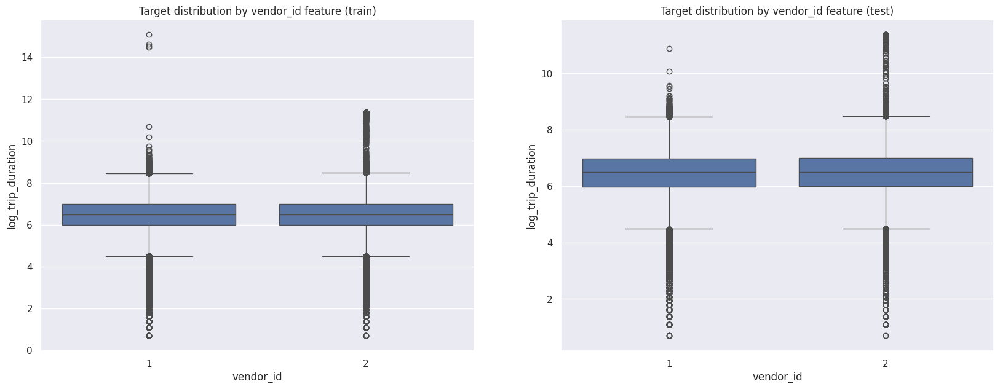

In [178]:
fig = plt.figure(figsize=(20, 7))
ax1 = fig.add_subplot(121)
sns.boxplot(x=X_train["vendor_id"], y=y_train, ax=ax1).set_title("Target distribution by vendor_id feature (train)")

ax2 = fig.add_subplot(122)
sns.boxplot(x=X_test["vendor_id"], y=y_test, ax=ax2).set_title("Target distribution by vendor_id feature (test)")

plt.show()

**Для passenger_count:**

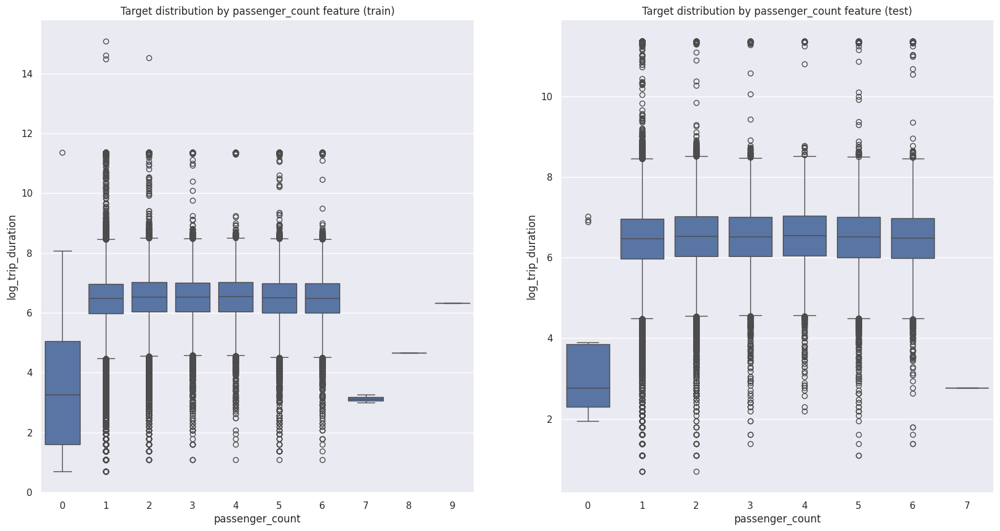

In [179]:
fig = plt.figure(figsize=(20, 10))
ax1 = fig.add_subplot(121)
sns.boxplot(x=X_train["passenger_count"], y=y_train, ax=ax1).set_title("Target distribution by passenger_count feature (train)")

ax2 = fig.add_subplot(122)
sns.boxplot(x=X_test["passenger_count"], y=y_test, ax=ax2).set_title("Target distribution by passenger_count feature (test)")

plt.show()

**Для store_and_fwd_flag:**

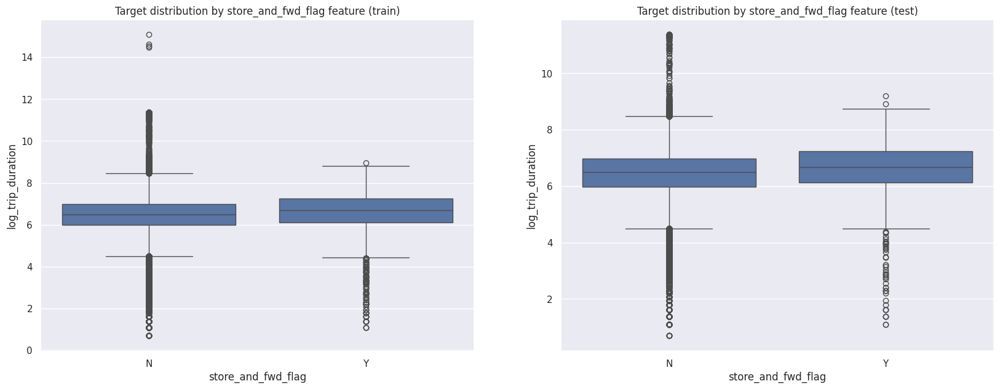

In [180]:
fig = plt.figure(figsize=(20, 7))
ax1 = fig.add_subplot(121)
sns.boxplot(x=X_train["store_and_fwd_flag"], y=y_train, ax=ax1).set_title("Target distribution by store_and_fwd_flag feature (train)")

ax2 = fig.add_subplot(122)
sns.boxplot(x=X_test["store_and_fwd_flag"], y=y_test, ax=ax2).set_title("Target distribution by store_and_fwd_flag feature (test)")

plt.show()

Переведите признаки `vendor_id` и `store_and_fwd_flag` в значения $\{0;1\}$

Знаем, что признак vendor_id принимает значения `1` и `2` => чтобы сделать единицу нулём, а двойку - единицей, вычтём из всех значений `vendor_id` единицу.

In [181]:
X_train["vendor_id"] -= 1

In [182]:
set(X_train["vendor_id"].values)

{0, 1}

In [183]:
X_test["vendor_id"] -= 1

In [184]:
set(X_test["vendor_id"].values)

{0, 1}

Значения признака store_and_fwd_flag перевёдем "в лоб".

In [185]:
X_train.loc[X_train["store_and_fwd_flag"] == "N", "store_and_fwd_flag"] = 0
X_train.loc[X_train["store_and_fwd_flag"] == "Y", "store_and_fwd_flag"] = 1

In [186]:
set(X_train["store_and_fwd_flag"].values)

{0, 1}

In [187]:
X_test.loc[X_test["store_and_fwd_flag"] == "N", "store_and_fwd_flag"] = 0
X_test.loc[X_test["store_and_fwd_flag"] == "Y", "store_and_fwd_flag"] = 1

In [188]:
set(X_test["store_and_fwd_flag"].values)

{0, 1}

**Вопрос**: Основываясь на графиках выше, как вы думаете, будут ли эти признаки сильными?

**Ответ:** Нет, эти признаки будут довольно слабыми, так как согласно боксплотам выше для каждого из этих признаков верно, что независимо от его значения распределение таргета почти одно и то же (различия между распределениями для разных значений того или иного нового признака крайне несущественные и в основном связаны с выбросами для боксплота (то, что выше верхнего уса, и то, что ниже нижнего уса)) => эти признаки не дают почти никакой новой информации => не улучшат качество нашего предсказания хоть сколько-нибудь значительно (единственное исключение - для признака `"passenger_count"` верно, что распределение таргета при значении этого признака, равном `0`, сильно отличается от распределений таргета при других значениях этого признака, но это некоторая аномалия, так как вообще говоря в реальном мире поездок на такси с 0 пассажиров очень мало (можно предположить, что это означает, что поездку отменили через какое-то время после вызова такси))

**Задание 12 (0.25 баллов)**. Проверьте свои предположения, обучив модель в том числе и на этих трех признаках. Обучайте `Ridge`-регрессию со стандартными параметрами. Категориальные признаки закодируйте one-hot-кодированием, а численные отмасштабируйте.

Оставим в `X_train` только колонки с новыми признаками (признаки, которые создавали и рассматривали в 1, 2 и 3 частях).

In [189]:
X_train.columns

Index(['month', 'hour', 'weekday', 'day_of_week', 'is_anomaly_1',
       'is_anomaly_2', 'day', 'haversine', 'log_haversine',
       'is_traffic_very_high', 'is_traffic_very_low',
       'was_pickup_in_JFK_airport', 'was_dropoff_in_JFK_airport',
       'was_pickup_in_LaGuardia_airport', 'was_dropoff_in_LaGuardia_airport',
       'manhattan_zone_pickup', 'manhattan_zone_dropoff', 'log_trip_duration',
       'store_and_fwd_flag', 'id', 'vendor_id', 'pickup_datetime',
       'passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'trip_duration'],
      dtype='object')

In [190]:
columns_to_drop = ['log_trip_duration', 'id', 'pickup_datetime',
                   'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude',
                   'trip_duration']

X_train_dropped = X_train[columns_to_drop] # сохраняем те колонки, что собираемся дропать, для будущих заданий

X_train.drop(columns=columns_to_drop, inplace=True)

In [191]:
X_train.head()

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,haversine,log_haversine,is_traffic_very_high,is_traffic_very_low,was_pickup_in_JFK_airport,was_dropoff_in_JFK_airport,was_pickup_in_LaGuardia_airport,was_dropoff_in_LaGuardia_airport,manhattan_zone_pickup,manhattan_zone_dropoff,store_and_fwd_flag,vendor_id,passenger_count
0,5,9,1,1,False,False,124,1.263187,0.816774,True,False,False,False,False,False,4,4,0,1,2
1,1,16,4,4,False,False,1,4.804012,1.758549,False,False,False,False,False,False,4,7,0,0,1
2,4,13,6,6,False,False,115,7.471088,2.136659,False,False,False,False,False,True,8,-1,0,0,1
3,1,17,6,6,False,False,10,3.444869,1.491750,False,False,False,False,False,False,1,4,0,1,1
4,2,17,3,3,False,False,56,2.481063,1.247338,True,False,False,False,False,False,4,7,0,0,1


То же самое сделаем с `X_test`:

In [192]:
X_test.columns

Index(['month', 'hour', 'weekday', 'day_of_week', 'is_anomaly_1',
       'is_anomaly_2', 'day', 'haversine', 'log_haversine',
       'is_traffic_very_high', 'is_traffic_very_low',
       'was_pickup_in_JFK_airport', 'was_dropoff_in_JFK_airport',
       'was_pickup_in_LaGuardia_airport', 'was_dropoff_in_LaGuardia_airport',
       'manhattan_zone_pickup', 'manhattan_zone_dropoff', 'log_trip_duration',
       'store_and_fwd_flag', 'id', 'vendor_id', 'pickup_datetime',
       'passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude'],
      dtype='object')

In [193]:
columns_to_drop = ['log_trip_duration', 'id', 'pickup_datetime',
                   'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude']

X_test_dropped = X_test[columns_to_drop] # сохраняем те колонки, что собираемся дропать, для будущих заданий

X_test.drop(columns=columns_to_drop, inplace=True)

In [194]:
X_test.head()

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,haversine,log_haversine,is_traffic_very_high,is_traffic_very_low,was_pickup_in_JFK_airport,was_dropoff_in_JFK_airport,was_pickup_in_LaGuardia_airport,was_dropoff_in_LaGuardia_airport,manhattan_zone_pickup,manhattan_zone_dropoff,store_and_fwd_flag,vendor_id,passenger_count
0,6,7,2,2,False,False,160,2.763050,1.325230,False,False,False,False,False,False,1,4,0,1,1
1,4,12,6,6,False,False,94,1.959178,1.084912,False,False,False,False,False,False,4,3,0,1,1
2,6,2,6,6,False,False,157,1.404772,0.877455,False,False,False,False,False,False,4,4,0,1,5
3,5,17,3,3,False,False,126,1.978660,1.091473,True,False,False,False,False,False,0,3,0,1,2
4,5,17,3,3,False,False,133,20.837745,3.083640,True,False,True,False,False,False,-1,4,0,0,4


Делаем фит-предикт.

In [195]:
categorical_features = ['day_of_week', 'month', 'hour', 'is_anomaly_1', 'is_anomaly_2', 'day',
                        'is_traffic_very_high', 'is_traffic_very_low',
                        'was_pickup_in_JFK_airport', 'was_dropoff_in_JFK_airport',
                        'was_pickup_in_LaGuardia_airport', 'was_dropoff_in_LaGuardia_airport',
                        'manhattan_zone_pickup', 'manhattan_zone_dropoff',
                        'store_and_fwd_flag', 'vendor_id', 'passenger_count'] # так как зависимость между таргетом и 'passenger_count' непохожа на линейную, нет никакого тренда, то будем считать 'passenger_count' - категориальным признаком
numeric_features = ['log_haversine', 'haversine']

column_transformer = ColumnTransformer([
    ('ohe', OneHotEncoder(), categorical_features),
    ('scaling', StandardScaler(), numeric_features)
])

pipeline = Pipeline(steps=[
    ('ohe_and_scaling', column_transformer),
    ('regression', Ridge())
])

model = pipeline.fit(X_train, y_train)
y_pred = model.predict(X_test)

print("Best_const_RMSLE =", rmsle_best_const)
print("Test_RMSLE =", rmsle(y_test, y_pred))

Best_const_RMSLE = 0.7950269011472101
Test_RMSLE = 0.470417375195925


В конце второй части получили: `Test_RMSLE = 0.47091164298838956`, сейчас - `Test_RMSLE = 0.470417375195925` => ошибка уменьшилась всего на `0.0005`, что совсем незначительно.

Если признаки не дали какого-то ощутимого улучшения метрики, их можно выбросить из данных.

Новые признаки очень слабо улучшили модель => выбросим их из `X_train` и `X_test`.

In [196]:
X_train.drop(columns=["store_and_fwd_flag", "vendor_id", "passenger_count"], inplace=True)

In [197]:
X_train.head()

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,haversine,log_haversine,is_traffic_very_high,is_traffic_very_low,was_pickup_in_JFK_airport,was_dropoff_in_JFK_airport,was_pickup_in_LaGuardia_airport,was_dropoff_in_LaGuardia_airport,manhattan_zone_pickup,manhattan_zone_dropoff
0,5,9,1,1,False,False,124,1.263187,0.816774,True,False,False,False,False,False,4,4
1,1,16,4,4,False,False,1,4.804012,1.758549,False,False,False,False,False,False,4,7
2,4,13,6,6,False,False,115,7.471088,2.136659,False,False,False,False,False,True,8,-1
3,1,17,6,6,False,False,10,3.444869,1.491750,False,False,False,False,False,False,1,4
4,2,17,3,3,False,False,56,2.481063,1.247338,True,False,False,False,False,False,4,7


In [198]:
X_test.drop(columns=["store_and_fwd_flag", "vendor_id", "passenger_count"], inplace=True)

In [201]:
X_test.head()

,month,hour,weekday,day_of_week,is_anomaly_1,is_anomaly_2,day,haversine,log_haversine,is_traffic_very_high,is_traffic_very_low,was_pickup_in_JFK_airport,was_dropoff_in_JFK_airport,was_pickup_in_LaGuardia_airport,was_dropoff_in_LaGuardia_airport,manhattan_zone_pickup,manhattan_zone_dropoff
0,6,7,2,2,False,False,160,2.763050,1.325230,False,False,False,False,False,False,1,4
1,4,12,6,6,False,False,94,1.959178,1.084912,False,False,False,False,False,False,4,3
2,6,2,6,6,False,False,157,1.404772,0.877455,False,False,False,False,False,False,4,4
3,5,17,3,3,False,False,126,1.978660,1.091473,True,False,False,False,False,False,0,3
4,5,17,3,3,False,False,133,20.837745,3.083640,True,False,True,False,False,False,-1,4
